# Pupose

The purpose of this notebook is to make sure all the analyses we are running make sense.

In [1]:
%matplotlib inline
%reload_ext autoreload
%autoreload 2

In [2]:
import pandas as pd
import xarray as xr
import numpy as np
import matplotlib.pyplot as plt
import seaborn as sns
sns.set(style='ticks', context='poster', font_scale=0.9,
            rc={'xtick.major.size': 3,
                'ytick.major.size': 3,
                'xtick.major.width': 1,
                'ytick.major.width': 1,
                'xtick.major.pad': 3.5,
                'ytick.major.pad': 3.5,
                'axes.linewidth': 1,
                'lines.linewidth': 2,
               })

In [3]:
epoch_key = ('HPa', 4, 2)

In [4]:
from src.parameters import (ANIMALS, SAMPLING_FREQUENCY,
                            MULTITAPER_PARAMETERS, FREQUENCY_BANDS,
                            RIPPLE_COVARIATES)

In [5]:
SAMPLING_FREQUENCY

1500

In [6]:
ANIMALS

{'HPa': Animal(short_name='HPa', directory='HPa_direct'),
 'HPb': Animal(short_name='HPb', directory='HPb_direct'),
 'HPc': Animal(short_name='HPc', directory='HPc_direct')}

## Ripple Detection

In [7]:
from src.analysis import detect_epoch_ripples

ripple_times = detect_epoch_ripples(
    epoch_key, ANIMALS, sampling_frequency=SAMPLING_FREQUENCY)

/usr3/graduate/edeno/.conda/envs/Jadhav-2016-Data-Analysis/lib/python3.5/site-packages/statsmodels/compat/pandas.py:56: FutureWarning: The pandas.core.datetools module is deprecated and will be removed in a future version. Please use the pandas.tseries module instead.
  from pandas.core import datetools


### Ripple Duration

Ripples should be greater than 0.015 seconds and ~0.100 seconds in duration.

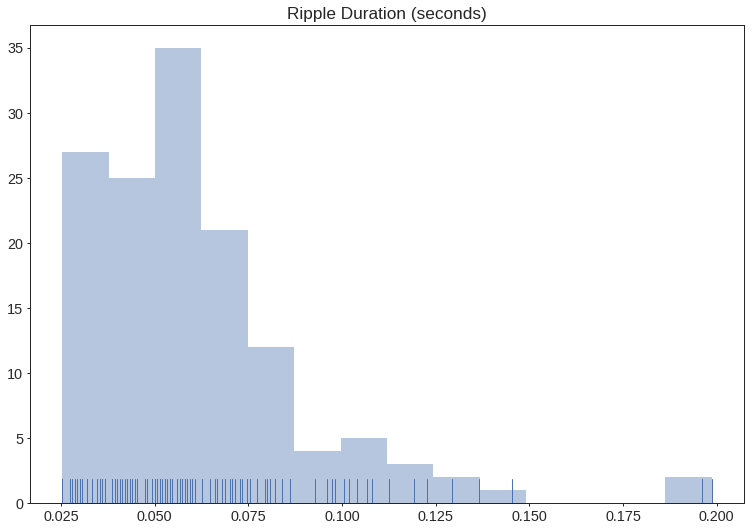

In [8]:
ripple_times = np.array(ripple_times)
ripple_duration = ripple_times[:, 1] - ripple_times[:, 0]
sns.distplot(ripple_duration, kde=False, rug=True);
plt.title('Ripple Duration (seconds)');

### Ripple speed

The animal should be running at a speed < 4 cm / second.

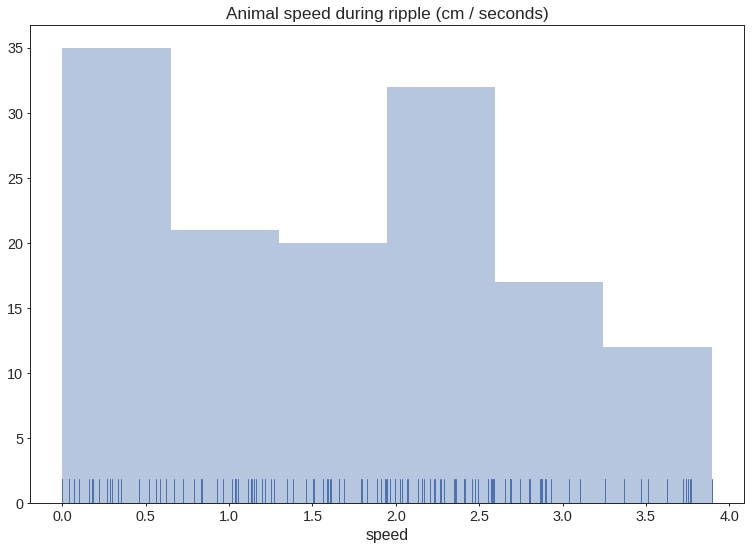

In [9]:
from src.data_processing import get_interpolated_position_dataframe

position_df = get_interpolated_position_dataframe(
    epoch_key, ANIMALS)
ripple_position = position_df.loc[ripple_times[:, 0]]

sns.distplot(ripple_position.speed, kde=False, rug=True);
plt.title('Animal speed during ripple (cm / seconds)');

### Location of animal during ripple

Animal should be mostly at reward wells or decision points

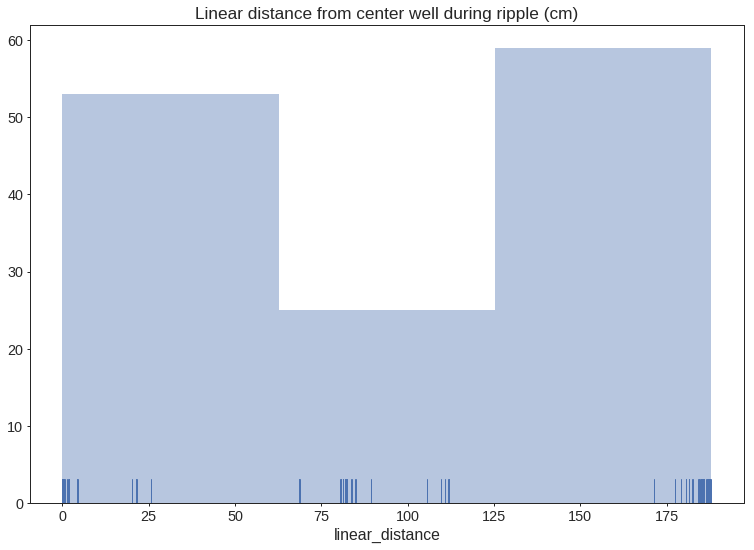

In [10]:
sns.distplot(ripple_position.linear_distance, rug=True, hist=True, kde=False);
plt.title('Linear distance from center well during ripple (cm)');

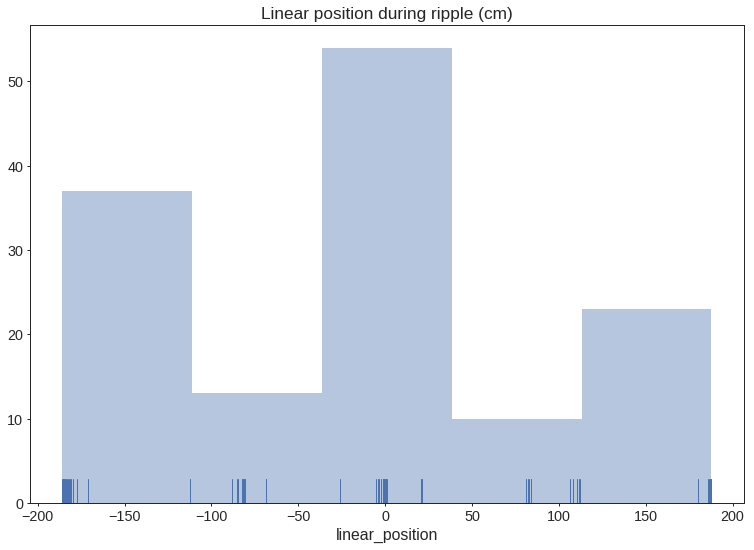

In [11]:
sns.distplot(ripple_position.linear_position, rug=True, hist=True, kde=False);
plt.title('Linear position during ripple (cm)');

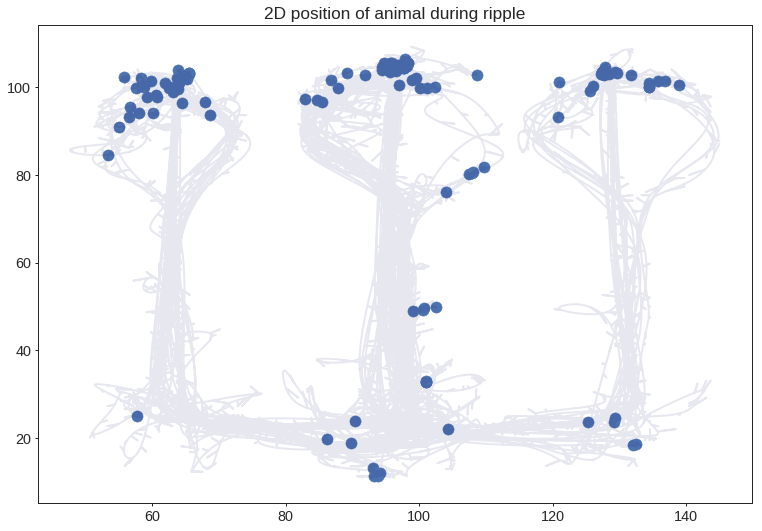

In [12]:
plt.plot(position_df.x_position, position_df.y_position, alpha=0.1, color='midnightblue')
hb = plt.scatter(ripple_position.x_position, ripple_position.y_position);
plt.title('2D position of animal during ripple');

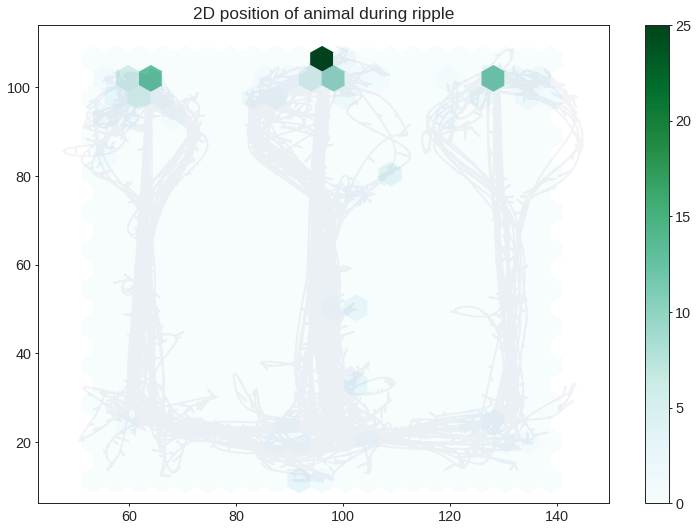

In [13]:
plt.plot(position_df.x_position, position_df.y_position, alpha=0.05, color='midnightblue')
hb = plt.hexbin(ripple_position.x_position, ripple_position.y_position,
                gridsize=20, cmap='BuGn');
plt.colorbar();
plt.title('2D position of animal during ripple');

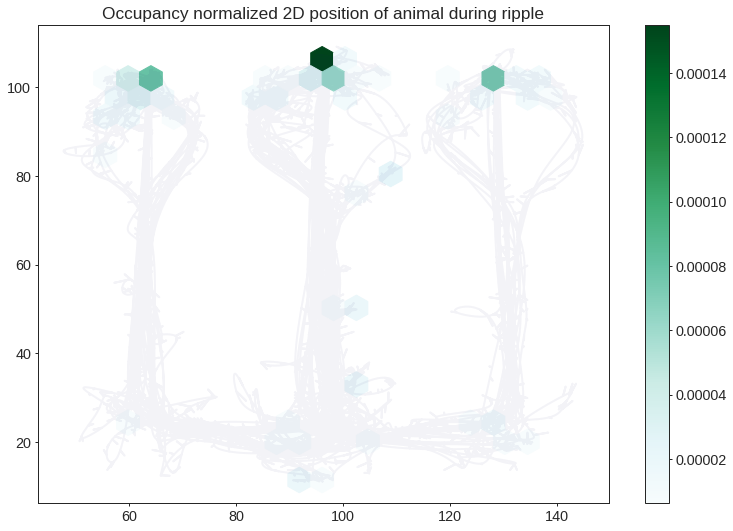

In [14]:
plt.subplot(111)
hb = plt.hexbin(position_df.x_position, position_df.y_position, gridsize=20)
plt.cla()
plt.plot(position_df.x_position, position_df.y_position, alpha=0.05, color='midnightblue')
plt.hexbin(ripple_position.x_position, ripple_position.y_position, gridsize=20,
           C=np.ones_like(position_df.y_position, dtype=np.float) / hb.get_array().max(),
           reduce_C_function=np.sum, cmap='BuGn')
cb = plt.colorbar();
plt.title('Occupancy normalized 2D position of animal during ripple');

### Task of animal during ripple

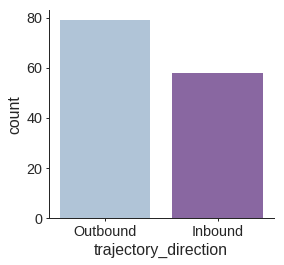

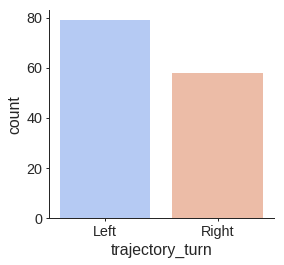

In [15]:
g = sns.factorplot(x="trajectory_direction", data=ripple_position, kind="count",
                   palette="BuPu")
g = sns.factorplot(x="trajectory_turn", data=ripple_position, kind='count',
                   palette="coolwarm")

### Ripple spectral power

Average LFP power of CA1 and iCA1 should be in the ripple frequency range (150-250 Hz)

Here are all the LFPs:

In [16]:
from src.data_processing import (get_LFP_dataframe, make_tetrode_dataframe)

tetrode_info = make_tetrode_dataframe(ANIMALS)[epoch_key]
tetrode_info = tetrode_info[
    ~tetrode_info.descrip.str.endswith('Ref').fillna(False)]
tetrode_info

area  depth descrip  numcells animal  day  \
animal day epoch tetrode_number                                              
HPa    4   2     1                CA1    114  riptet        10    HPa    4   
                 2                CA1    121     NaN         0    HPa    4   
                 4                CA1    117  riptet        15    HPa    4   
                 5                CA1    117  riptet         3    HPa    4   
                 6                CA1    110  riptet         0    HPa    4   
                 7                CA1    114  riptet         1    HPa    4   
                 8               iCA1    114  riptet         2    HPa    4   
                 9               iCA1    101  riptet         2    HPa    4   
                 10              iCA1     98     NaN         0    HPa    4   
                 11              iCA1    108  riptet         1    HPa    4   
                 12              iCA1    116  riptet         0    HPa    4   
                 13              iCA1    120     NaN         0    HPa    4   
                 14              iCA1    105  riptet         4    HPa    4   
                 15               PFC    116     NaN         3    HPa    4   
                 16               PFC    118     NaN         0    HPa    4   
                 17               PFC    119     NaN         0    HPa    4   
                 18               PFC    108     NaN         0    HPa    4   
                 19               PFC    126     NaN         0    HPa    4   
                 20               PFC    109     NaN         0    HPa    4   

                                 epoch  tetrode_number tetrode_id  
animal day epoch tetrode_number                                    
HPa    4   2     1                   2               1     HPa421  
                 2                   2               2     HPa422  
                 4                   2               4     HPa424  
                 5                   2               5     HPa425  
                 6                   2               6     HPa426  
                 7                   2               7     HPa427  
                 8                   2               8     HPa428  
                 9                   2               9     HPa429  
                 10                  2              10    HPa4210  
                 11                  2              11    HPa4211  
                 12                  2              12    HPa4212  
                 13                  2              13    HPa4213  
                 14                  2              14    HPa4214  
                 15                  2              15    HPa4215  
                 16                  2              16    HPa4216  
                 17                  2              17    HPa4217  
                 18                  2              18    HPa4218  
                 19                  2              19    HPa4219  
                 20                  2              20    HPa4220

In [17]:
lfps = {tetrode_key: get_LFP_dataframe(tetrode_key, ANIMALS)
        for tetrode_key in tetrode_info.index}

We focus on the ripple band with the following parameters:

In [18]:
MULTITAPER_PARAMETERS['20Hz_Resolution']

{'sampling_frequency': 1500,
 'time_halfbandwidth_product': 1,
 'time_window_duration': 0.05,
 'time_window_step': 0.05,
 'window_of_interest': (-0.45, 0.5)}

In [19]:
FREQUENCY_BANDS['ripple']

(150, 250)

We find the ripple-locked LFPs (thick black line is ripple-locked event related potential):

In [20]:
from copy import deepcopy
from functools import partial
from src.data_processing import reshape_to_segments
from src.analysis import _subtract_event_related_potential

params = deepcopy(MULTITAPER_PARAMETERS['20Hz_Resolution'])
window_of_interest = params.pop('window_of_interest')
reshape_to_trials = partial(
    reshape_to_segments,
    sampling_frequency=params['sampling_frequency'],
    window_offset=window_of_interest, concat_axis=1)

Verify that reshaping the LFP relative to the ripple times works by plotting a single ripple and outlining the ripple start and end:

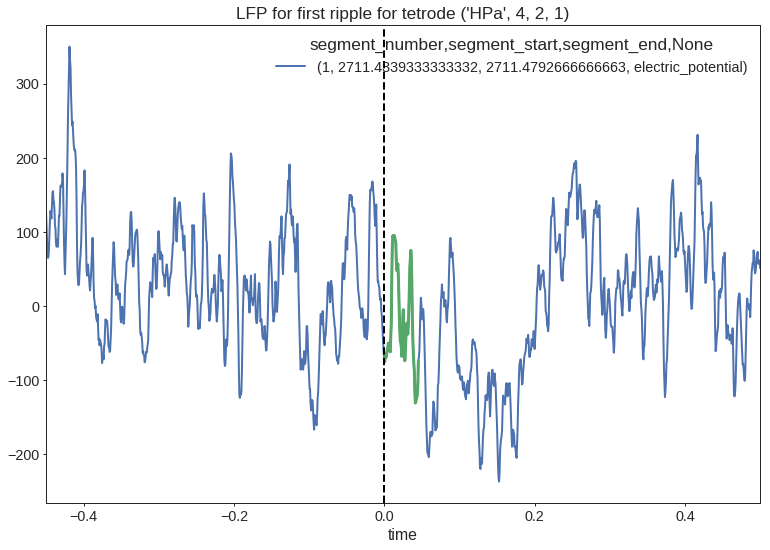

In [21]:
tetrode_key = ('HPa', 4, 2, 1)
ripple_locked_lfp = reshape_to_trials(lfps[tetrode_key], ripple_times[0:1])
ax = ripple_locked_lfp.plot()
ripple_start, ripple_end = ripple_times[0]
ripple1 = lfps[tetrode_key].loc[slice(ripple_start, ripple_end)]
ax.plot(ripple1.index - ripple_start, ripple1.values, linewidth=3);
ax.set_title('LFP for first ripple for tetrode {0}'.format(tetrode_key));
ax.axvline(0, color='black', linestyle='--');

Try a different tetrode and ripple

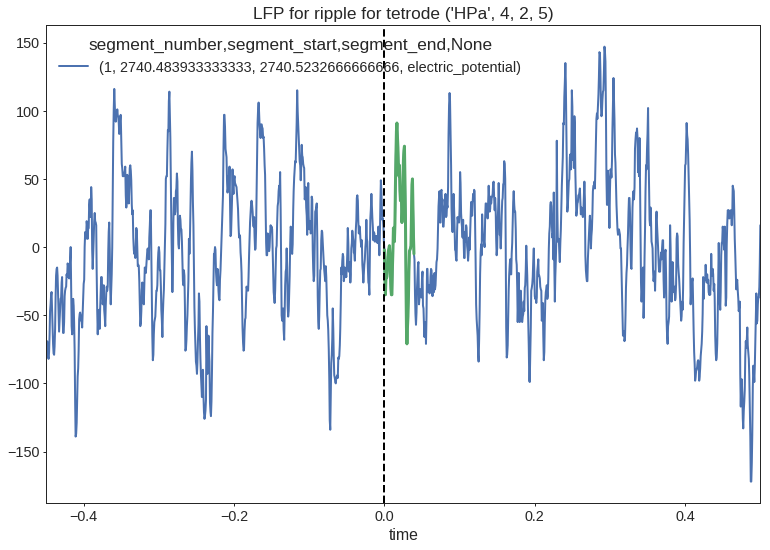

In [22]:
tetrode_key = ('HPa', 4, 2, 5)
ripple_locked_lfp = reshape_to_trials(lfps[tetrode_key], ripple_times[5:6])
ax = ripple_locked_lfp.plot()
ripple_start, ripple_end = ripple_times[5]
ripple1 = lfps[tetrode_key].loc[slice(ripple_start, ripple_end)]
ax.plot(ripple1.index - ripple_start, ripple1.values, linewidth=3);
ax.set_title('LFP for ripple for tetrode {0}'.format(tetrode_key));
ax.axvline(0, color='black', linestyle='--');

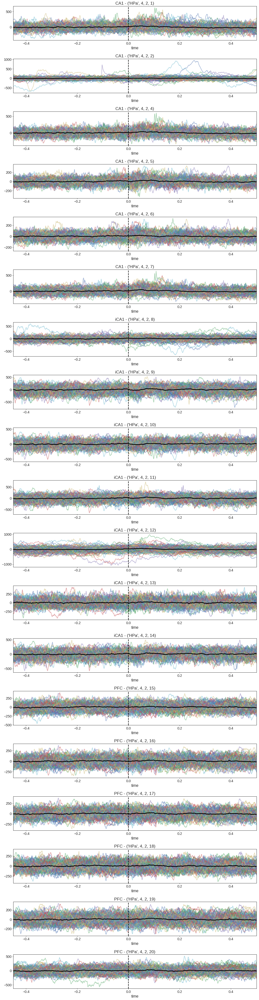

In [23]:
fig, axes = plt.subplots(len(tetrode_info), 1, figsize=(15, 3 * len(tetrode_info)))
for ax, (tetrode_key, info) in zip(axes, tetrode_info.iterrows()):
    ripple_locked_lfp = reshape_to_trials(lfps[tetrode_key], ripple_times)
    ripple_locked_lfp.plot(legend=False, alpha=0.5, ax=ax);
    ripple_locked_lfp.mean(axis=1).plot(color='black', linewidth=3, ax=ax);
    ax.axvline(0, color='black', linestyle='--');
    ax.set_title('{brain_area} - {tetrode_id}'.format(brain_area=info.area, tetrode_id=tetrode_key))
    
plt.tight_layout()

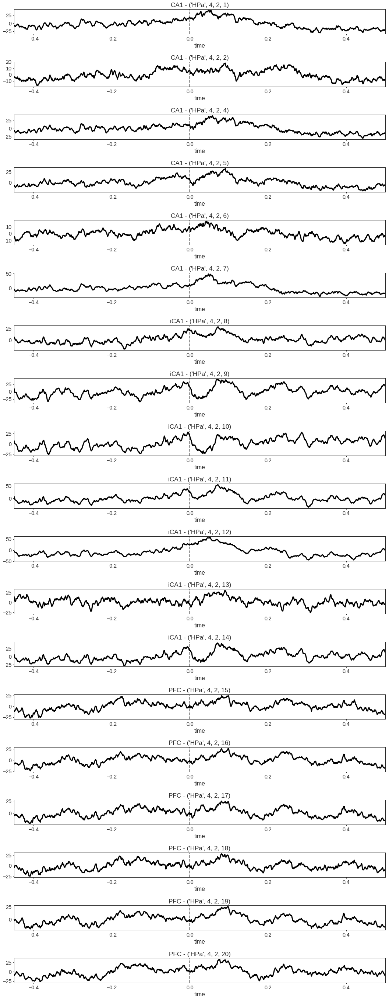

In [24]:
fig, axes = plt.subplots(len(tetrode_info), 1, figsize=(15, 2 * len(tetrode_info)))
for ax, (tetrode_key, info) in zip(axes, tetrode_info.iterrows()):
    ripple_locked_lfp = reshape_to_trials(lfps[tetrode_key], ripple_times)
    ripple_locked_lfp.mean(axis=1).plot(color='black', linewidth=3, ax=ax);
    ax.axvline(0, color='black', linestyle='--');
    ax.set_title('{brain_area} - {tetrode_id}'.format(brain_area=info.area, tetrode_id=tetrode_key))
    
plt.tight_layout()

Subtract the event related potential (thick black line should be 0 over all time):

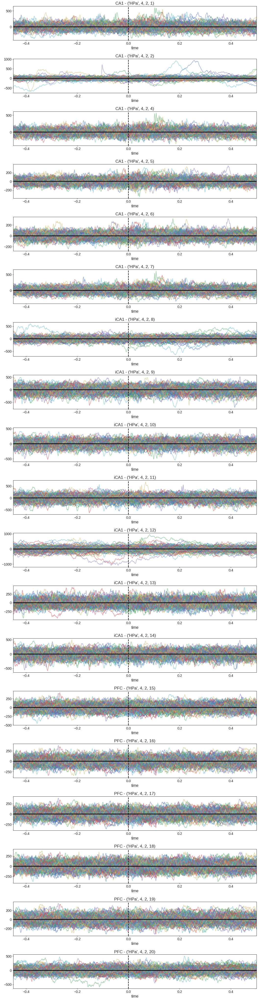

In [25]:
ripple_locked_lfps = pd.Panel({
    lfp_name: _subtract_event_related_potential(
        reshape_to_trials(lfps[lfp_name], ripple_times))
    for lfp_name in lfps}).dropna(axis=2)

fig, axes = plt.subplots(len(tetrode_info), 1, figsize=(15, 3 * len(tetrode_info)))
for ax, (tetrode_key, info) in zip(axes, tetrode_info.iterrows()):
    ripple_locked_lfp = ripple_locked_lfps.loc[tetrode_key]
    ripple_locked_lfp.plot(legend=False, alpha=0.5, ax=ax);
    ripple_locked_lfp.mean(axis=1).plot(color='black', linewidth=3, ax=ax);
    ax.axvline(0, color='black', linestyle='--');
    ax.set_title('{brain_area} - {tetrode_id}'.format(brain_area=info.area, tetrode_id=tetrode_key))
    
plt.tight_layout()

Now find the power in the ripple band:

In [26]:
from src.spectral.connectivity import Connectivity
from src.spectral.transforms import Multitaper

m = Multitaper(
    np.rollaxis(ripple_locked_lfps.values, 0, 3),
    **params,
    start_time=ripple_locked_lfps.major_axis.min())
c = Connectivity.from_multitaper(m)

In [27]:
from src.analysis import _center_time

dimension_names = ['time', 'frequency', 'tetrode']
data_vars = {
 'power': (dimension_names, c.power())}
coordinates = {
    'time': _center_time(c.time),
    'frequency': c.frequencies + np.diff(c.frequencies)[0] / 2,
    'tetrode': tetrode_info.tetrode_id.values,
    'brain_area': ('tetrode', tetrode_info.area.tolist()),
}

ripple_power = xr.Dataset(data_vars, coords=coordinates).sel(
    frequency=slice(FREQUENCY_BANDS['ripple'][0], FREQUENCY_BANDS['ripple'][1])
).power

#### Raw ripple-locked power for each tetrode

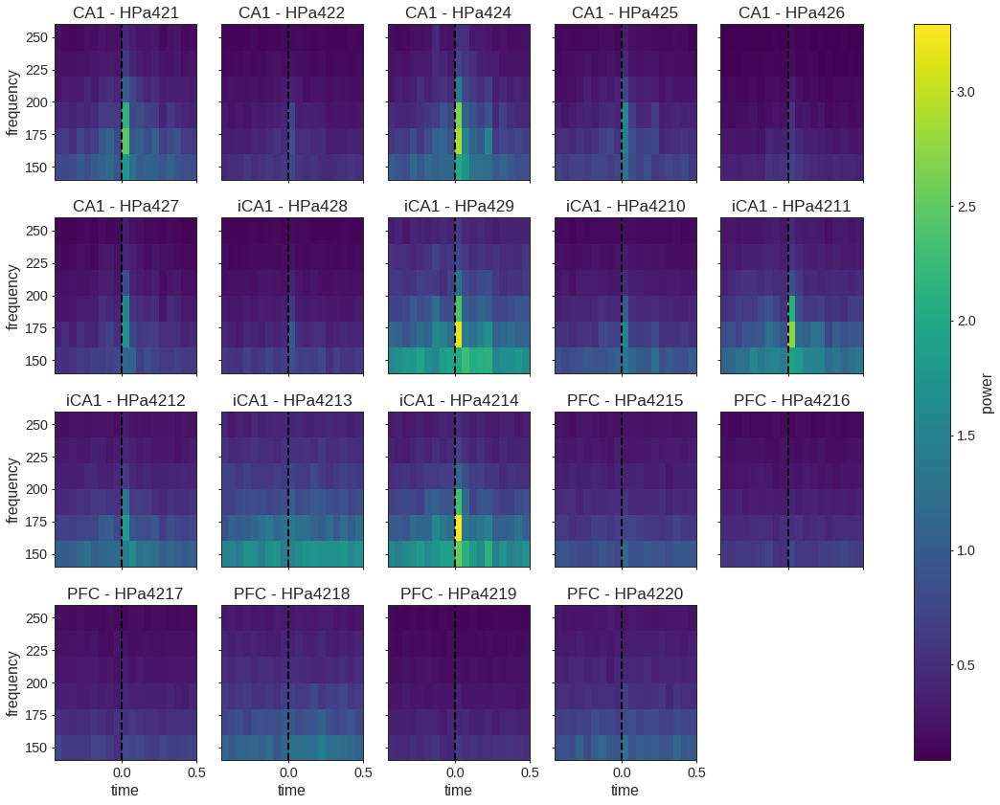

In [28]:
g = ripple_power.plot(x='time', y='frequency', col='tetrode', col_wrap=5);

for ax, area, tetrode in zip(g.axes.ravel().tolist(), g.data.brain_area, g.data.tetrode):
    ax.set_title(
        '{brain_area} - {tetrode_id}'.format(brain_area=area.values, tetrode_id=tetrode.values))
    ax.axvline(0, color='black', linestyle='--')

#### Change in ripple-locked power for each tetrode for before ripple

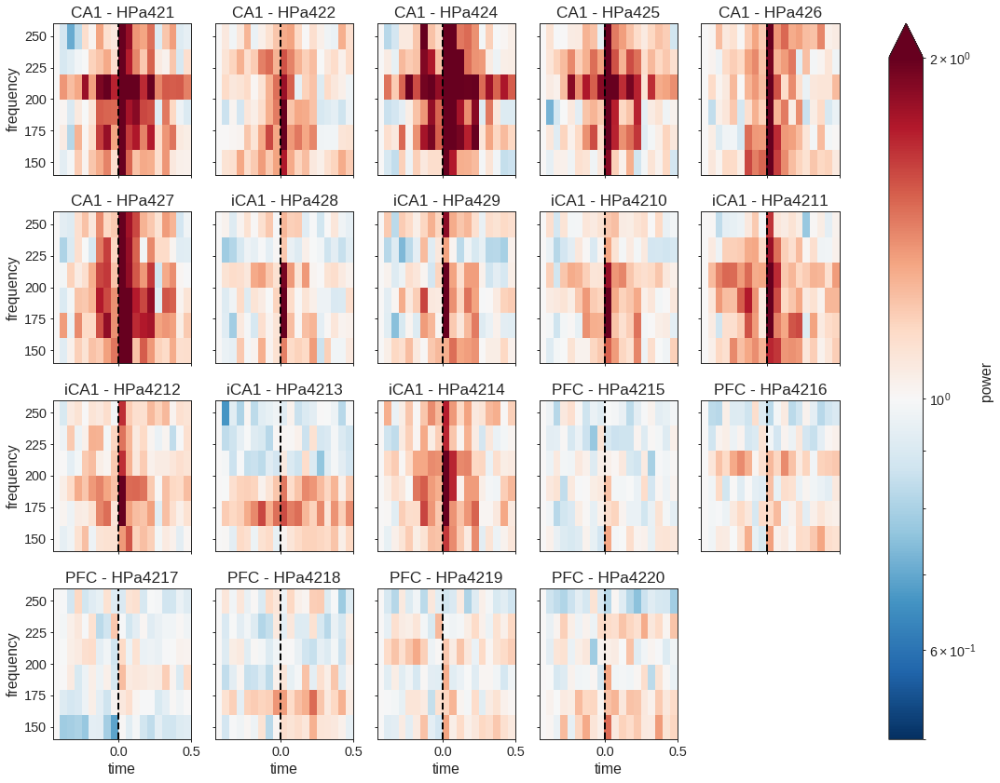

In [29]:
from matplotlib.colors import LogNorm
vmin, vmax = 0.5, 2
g = (ripple_power / ripple_power.isel(time=0)).plot(
    x='time', y='frequency', col='tetrode', col_wrap=5, center=0,
    norm=LogNorm(vmin=vmin, vmax=vmax), vmin=vmin, vmax=vmax, cmap='RdBu_r');

for ax, area, tetrode in zip(g.axes.ravel().tolist(), g.data.brain_area, g.data.tetrode):
    ax.set_title(
        '{brain_area} - {tetrode_id}'.format(brain_area=area.values, tetrode_id=tetrode.values))
    ax.axvline(0, color='black', linestyle='--')

### Ripple-locked Connectivity

#### Coherence

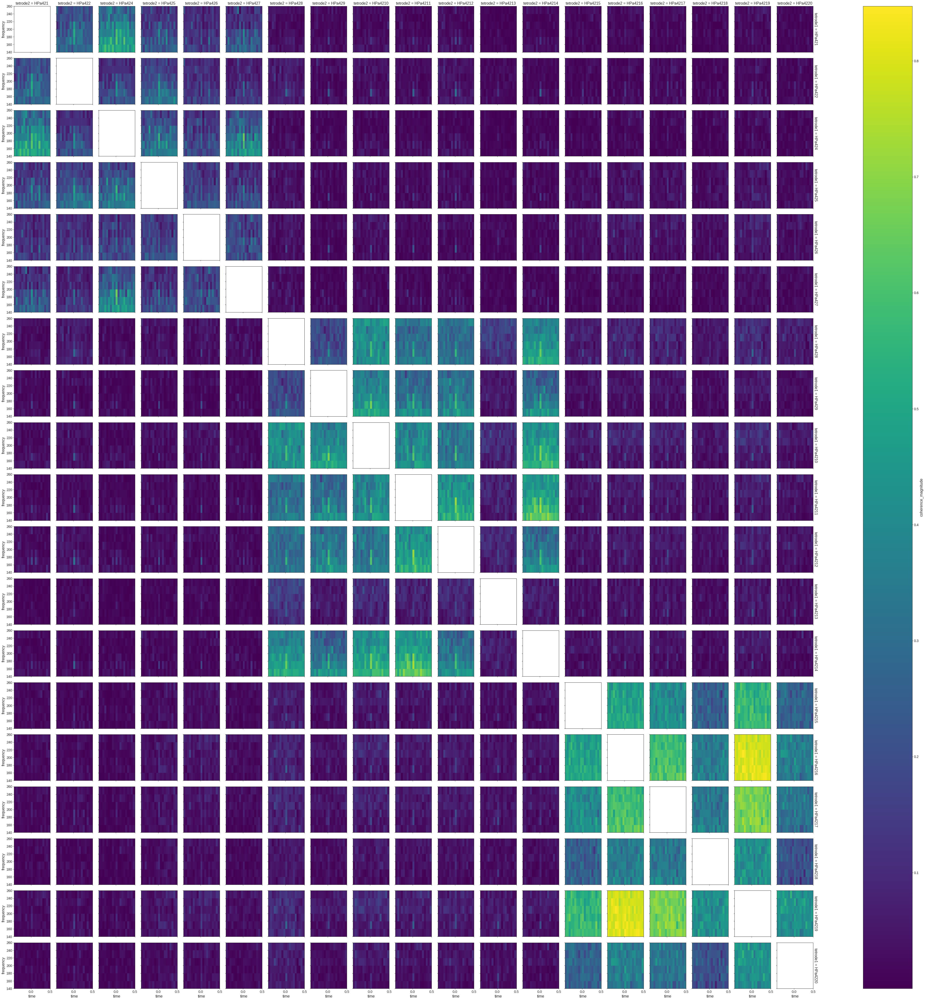

In [30]:
dimension_names = ['time', 'frequency', 'tetrode1', 'tetrode2']
data_vars = {
 'coherence_magnitude': (dimension_names, c.coherence_magnitude())}
coordinates = {
    'time': _center_time(c.time),
    'frequency': c.frequencies + np.diff(c.frequencies)[0] / 2,
    'tetrode1': tetrode_info.tetrode_id.values,
    'tetrode2': tetrode_info.tetrode_id.values,
    'brain_area1': ('tetrode1', tetrode_info.area.tolist()),
    'brain_area2': ('tetrode2', tetrode_info.area.tolist()),
}

coherence_magnitude = xr.Dataset(data_vars, coords=coordinates)
coherence_magnitude = coherence_magnitude.sel(
    frequency=slice(FREQUENCY_BANDS['ripple'][0], FREQUENCY_BANDS['ripple'][1])
).coherence_magnitude

coherence_magnitude.plot(x='time', y='frequency', row='tetrode1', col='tetrode2');

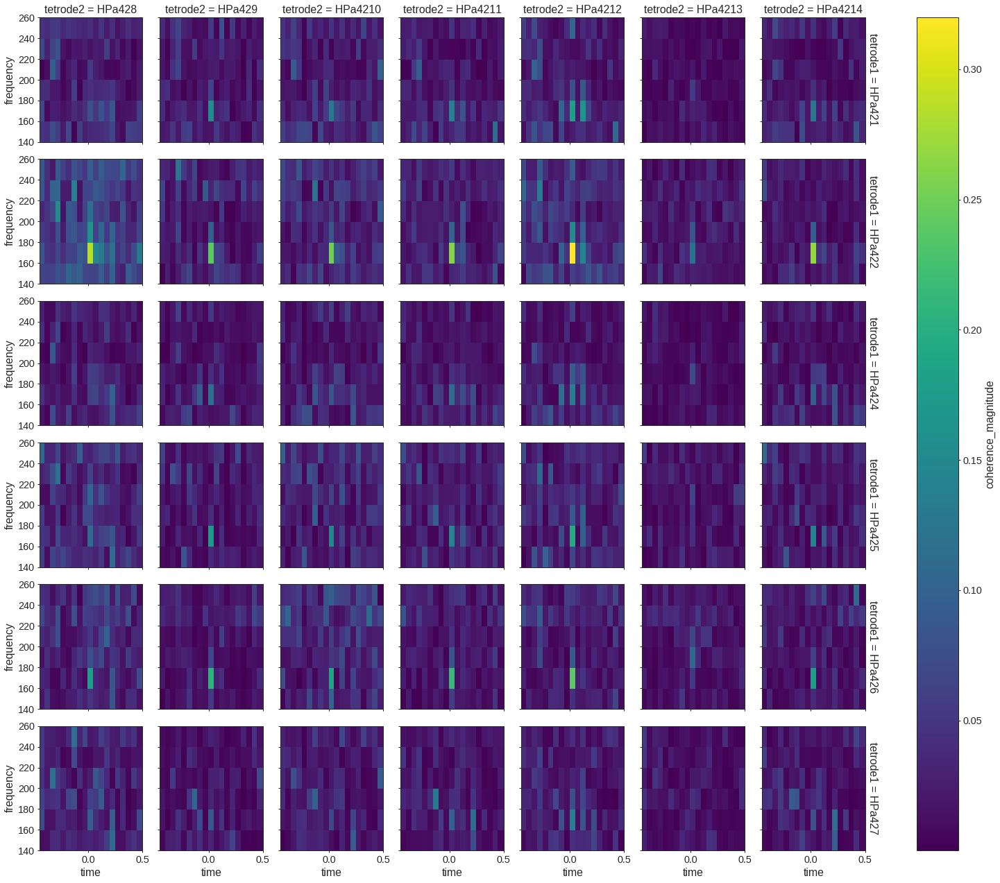

In [31]:
coherence_magnitude.sel(
    tetrode1=coherence_magnitude.tetrode1[coherence_magnitude.brain_area1 == 'CA1'],
    tetrode2=coherence_magnitude.tetrode2[coherence_magnitude.brain_area2 == 'iCA1']
).plot(x='time', y='frequency', row='tetrode1', col='tetrode2');

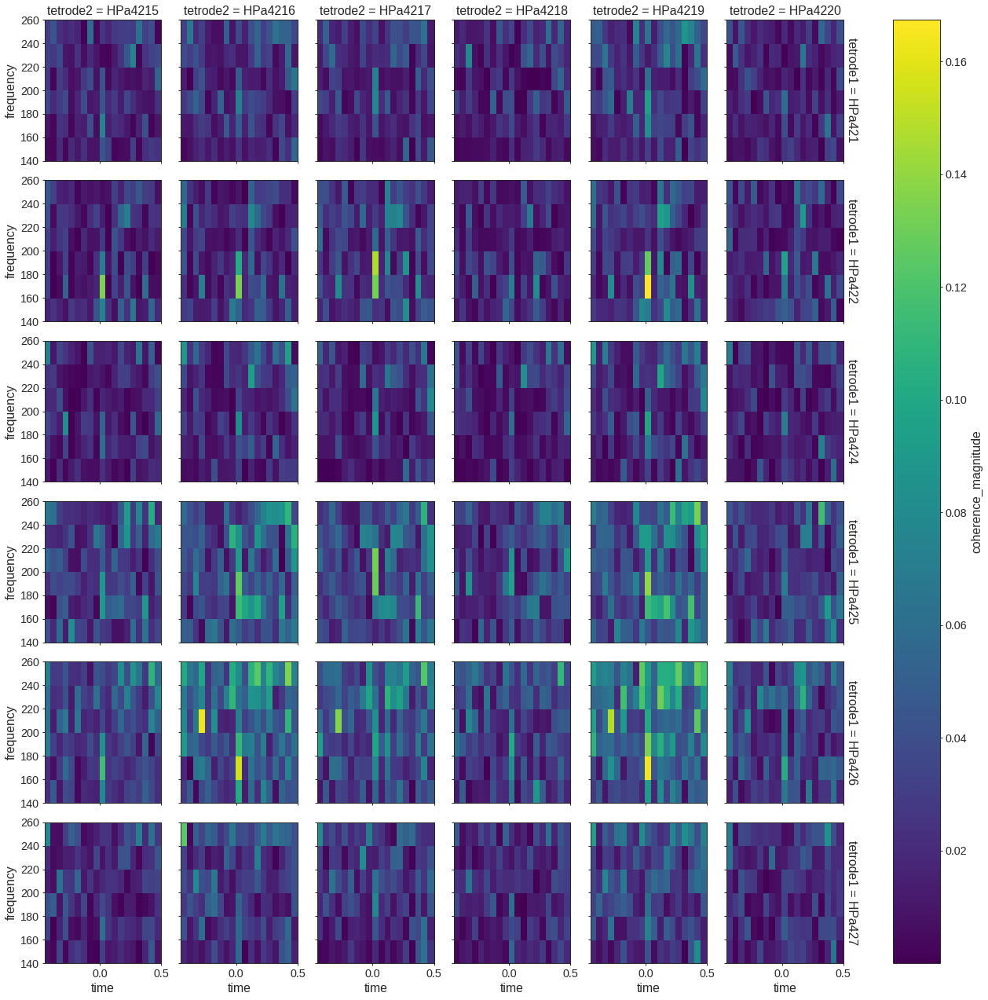

In [32]:
coherence_magnitude.sel(
    tetrode1=coherence_magnitude.tetrode1[coherence_magnitude.brain_area1 == 'CA1'],
    tetrode2=coherence_magnitude.tetrode2[coherence_magnitude.brain_area2 == 'PFC']
).plot(x='time', y='frequency', row='tetrode1', col='tetrode2');

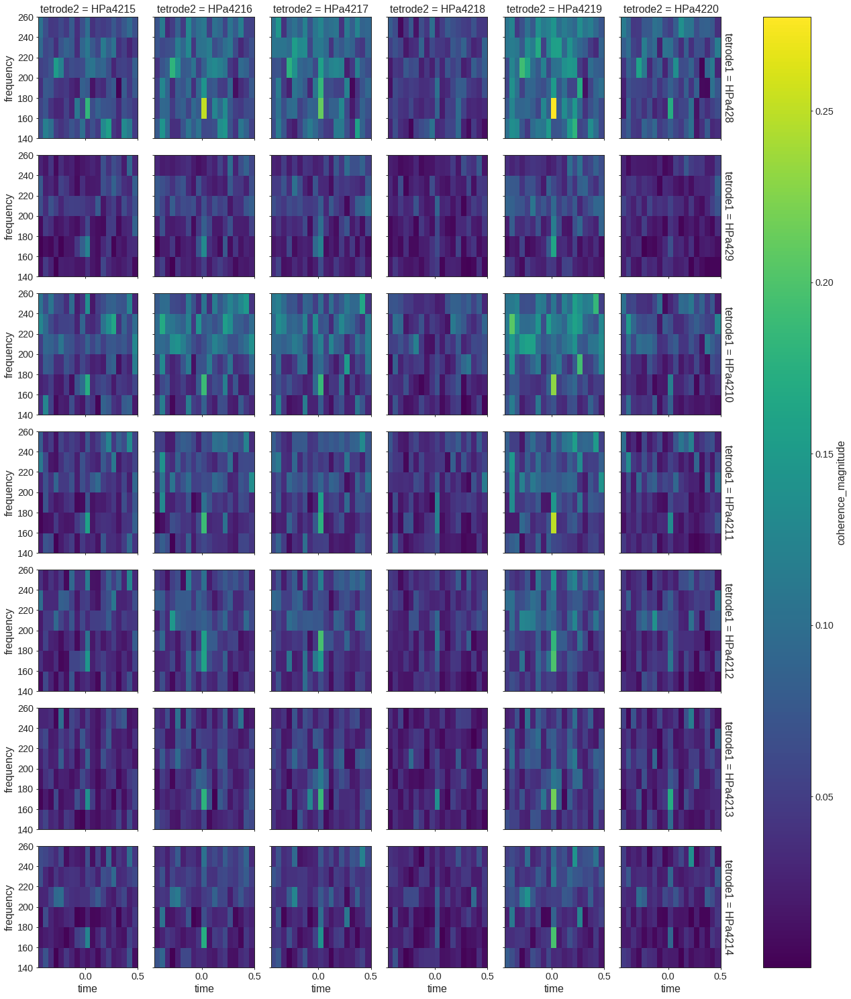

In [33]:
coherence_magnitude.sel(
    tetrode1=coherence_magnitude.tetrode1[coherence_magnitude.brain_area1 == 'iCA1'],
    tetrode2=coherence_magnitude.tetrode2[coherence_magnitude.brain_area2 == 'PFC']
).plot(x='time', y='frequency', row='tetrode1', col='tetrode2');

### Canonical Coherence

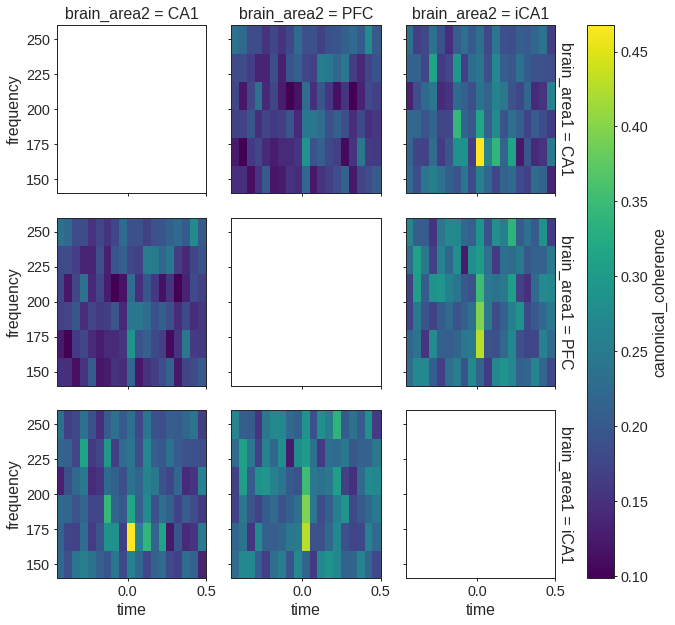

In [34]:
canonical_coherence, area_labels = c.canonical_coherence(
    tetrode_info.area.tolist())
dimension_names = ['time', 'frequency', 'brain_area1', 'brain_area2']
data_vars = {
    'canonical_coherence': (dimension_names, canonical_coherence)}
coordinates = {
    'time': _center_time(c.time),
    'frequency': c.frequencies + np.diff(c.frequencies)[0] / 2,
    'brain_area1': area_labels,
    'brain_area2': area_labels,
}
canonical_coherence = xr.Dataset(data_vars, coords=coordinates).sel(
    frequency=slice(FREQUENCY_BANDS['ripple'][0], FREQUENCY_BANDS['ripple'][1])
).canonical_coherence
canonical_coherence.plot(x='time', y='frequency', row='brain_area1', col='brain_area2');

### Group Delay

In [35]:
group_delay = np.array(
    [c.group_delay(FREQUENCY_BANDS[frequency_band],
                   frequency_resolution=m.frequency_resolution)
     for frequency_band in FREQUENCY_BANDS])

dimension_names = ['frequency_band', 'time', 'tetrode1', 'tetrode2']
data_vars = {
    'delay': (dimension_names, group_delay[:, 0, ...]),
    'slope': (dimension_names, group_delay[:, 1, ...]),
    'r_value': (dimension_names, group_delay[:, 2, ...])}

coordinates = {
    'time': _center_time(c.time),
    'frequency_band': list(FREQUENCY_BANDS.keys()),
    'tetrode1': tetrode_info.tetrode_id.values,
    'tetrode2': tetrode_info.tetrode_id.values,
    'brain_area1': ('tetrode1', tetrode_info.area.tolist()),
    'brain_area2': ('tetrode2', tetrode_info.area.tolist()),
    }

group_delay = xr.Dataset(data_vars, coords=coordinates).sel(frequency_band='ripple').delay

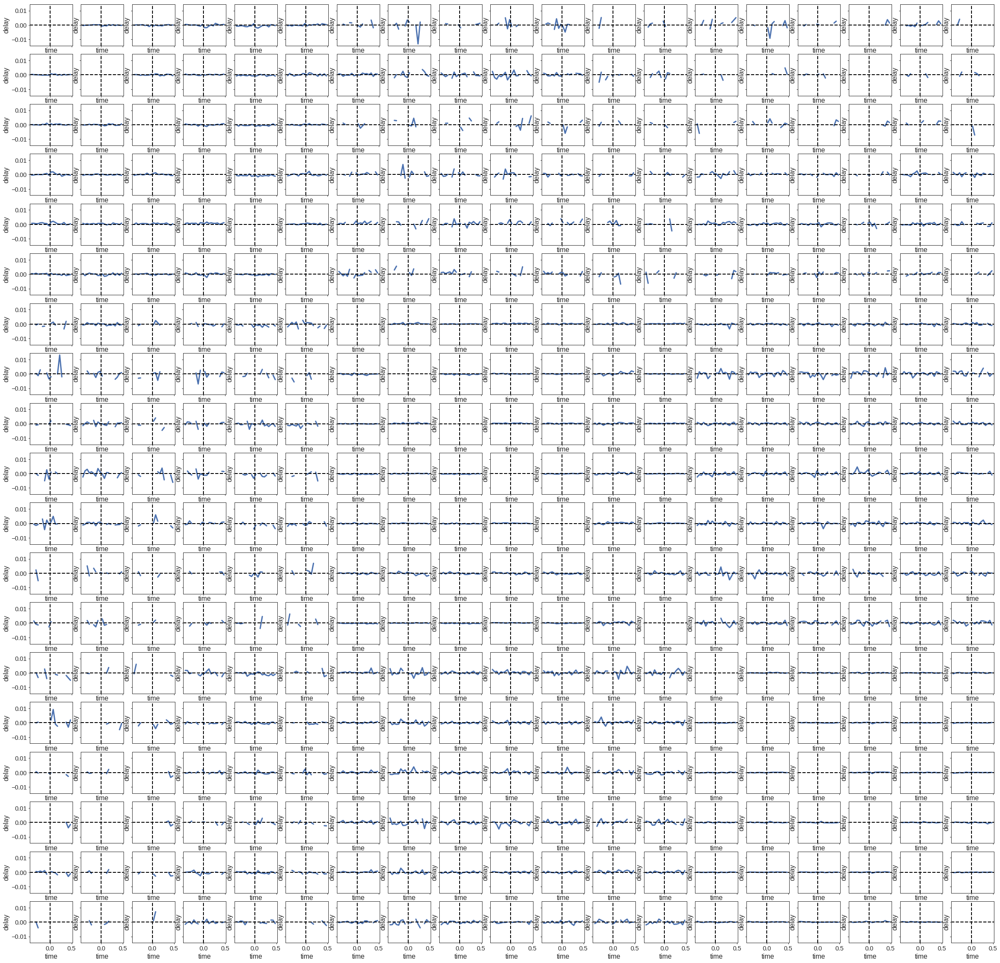

In [36]:
n_tetrodes = len(tetrode_info)
fig, ax = plt.subplots(n_tetrodes, n_tetrodes, sharex=True, sharey=True, figsize=(40, 40))
from itertools import product

for ind1, ind2 in product(range(n_tetrodes), range(n_tetrodes)):
    group_delay.isel(tetrode1=ind1, tetrode2=ind2).plot(ax=ax[ind1, ind2], linewidth=3);
    ax[ind1, ind2].set_title('')
    ax[ind1, ind2].axvline(0, color='black', linestyle='--')
    ax[ind1, ind2].axhline(0, color='black', linestyle='--')

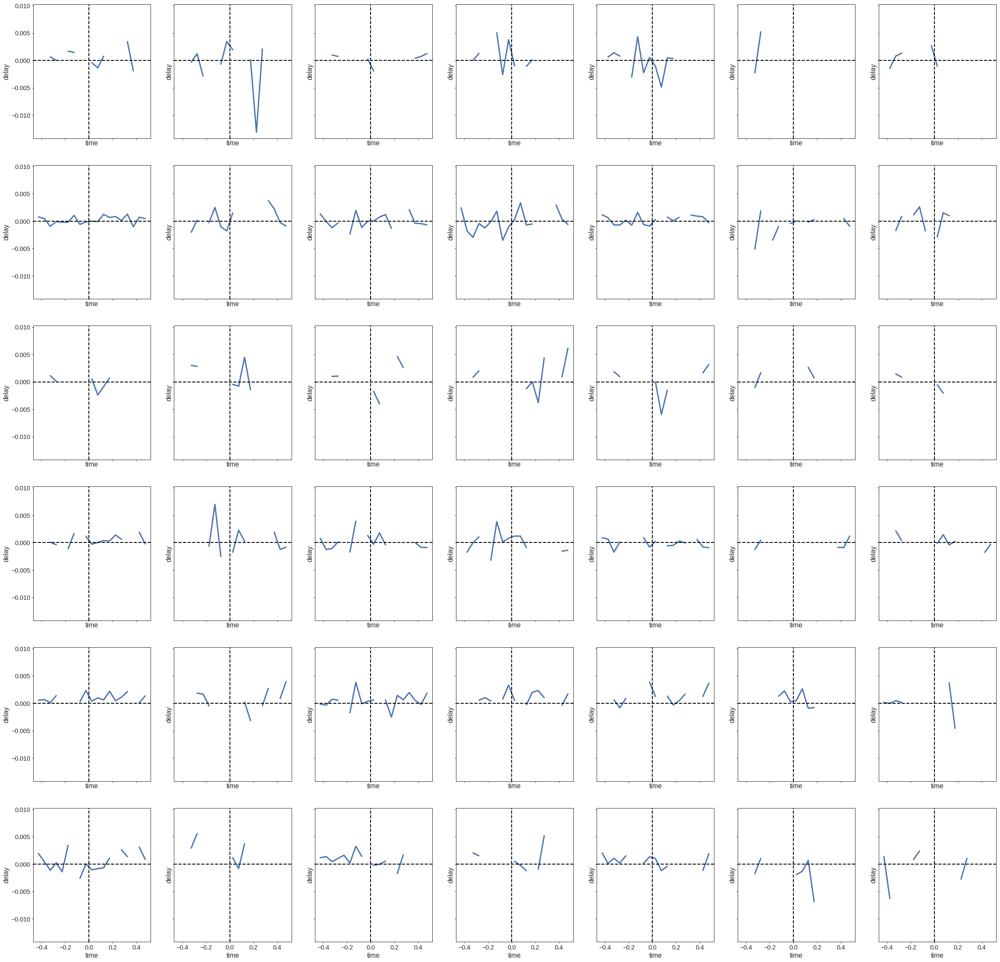

In [37]:
cur_gd = group_delay.sel(
    tetrode1=group_delay.tetrode1[group_delay.brain_area1 == 'CA1'],
    tetrode2=group_delay.tetrode2[group_delay.brain_area2 == 'iCA1'])
_, n_tetrodes1, n_tetrodes2 = cur_gd.shape

fig, ax = plt.subplots(n_tetrodes1, n_tetrodes2, sharex=True, sharey=True, figsize=(40, 40))

for ind1, ind2 in product(range(n_tetrodes1), range(n_tetrodes2)):
    cur_gd.isel(tetrode1=ind1, tetrode2=ind2).plot(ax=ax[ind1, ind2], linewidth=3);
    ax[ind1, ind2].set_title('', fontsize=5)
    ax[ind1, ind2].axvline(0, color='black', linestyle='--')
    ax[ind1, ind2].axhline(0, color='black', linestyle='--')

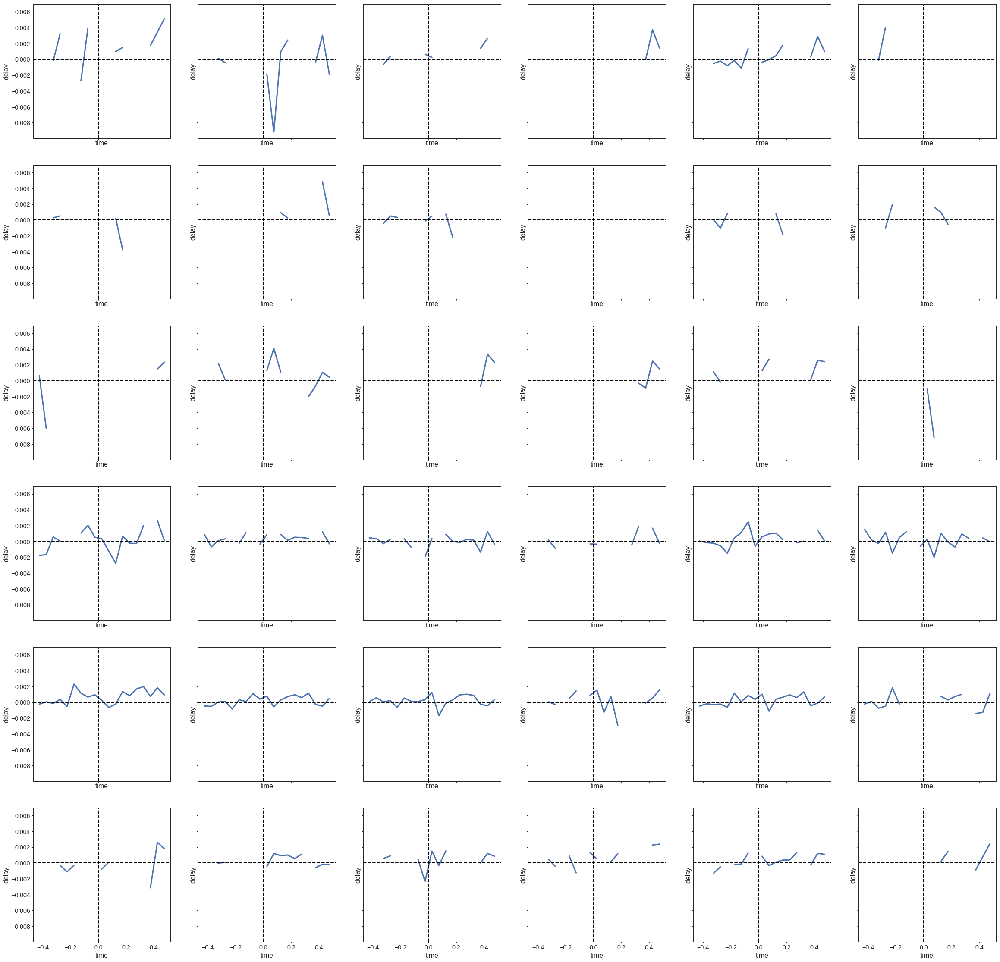

In [38]:
cur_gd = group_delay.sel(
    tetrode1=group_delay.tetrode1[group_delay.brain_area1 == 'CA1'],
    tetrode2=group_delay.tetrode2[group_delay.brain_area2 == 'PFC'])
_, n_tetrodes1, n_tetrodes2 = cur_gd.shape

fig, ax = plt.subplots(n_tetrodes1, n_tetrodes2, sharex=True, sharey=True, figsize=(40, 40))

for ind1, ind2 in product(range(n_tetrodes1), range(n_tetrodes2)):
    cur_gd.isel(tetrode1=ind1, tetrode2=ind2).plot(ax=ax[ind1, ind2], linewidth=3);
    ax[ind1, ind2].set_title('')
    ax[ind1, ind2].axvline(0, color='black', linestyle='--')
    ax[ind1, ind2].axhline(0, color='black', linestyle='--')

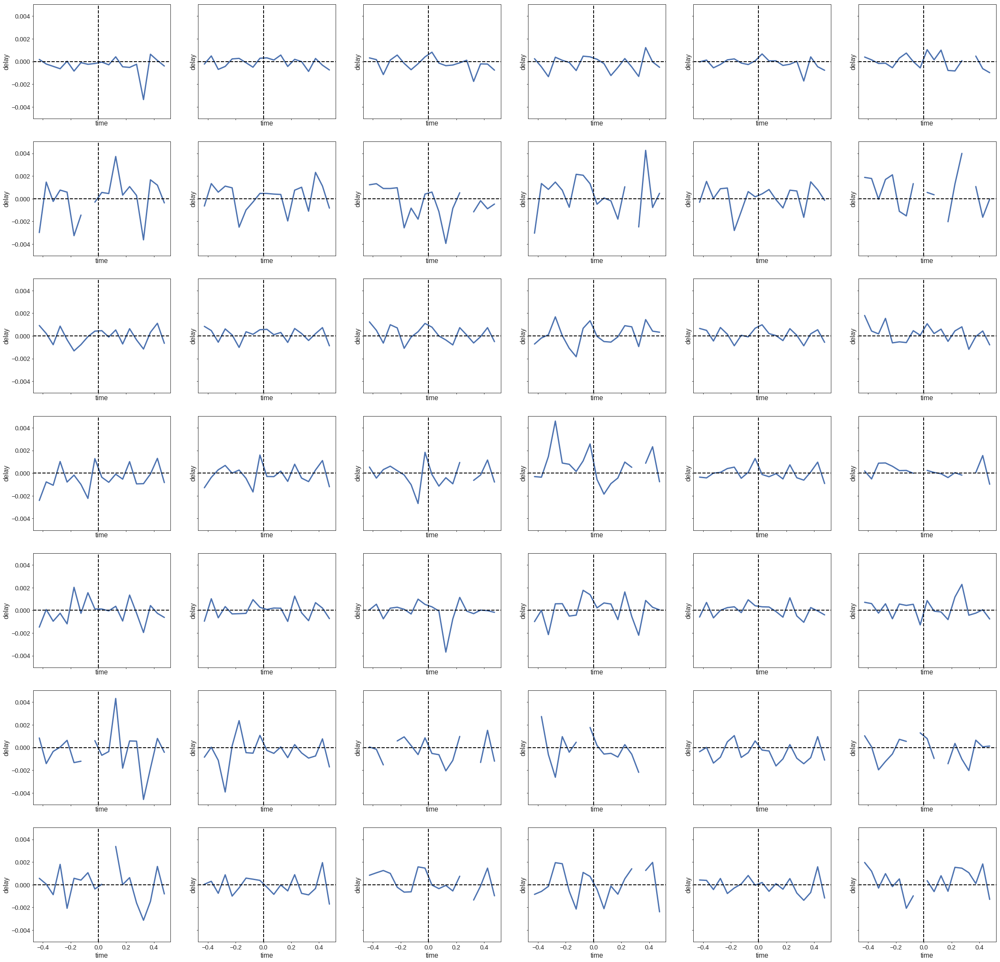

In [39]:
cur_gd = group_delay.sel(
    tetrode1=group_delay.tetrode1[group_delay.brain_area1 == 'iCA1'],
    tetrode2=group_delay.tetrode2[group_delay.brain_area2 == 'PFC'])
_, n_tetrodes1, n_tetrodes2 = cur_gd.shape

fig, ax = plt.subplots(n_tetrodes1, n_tetrodes2, sharex=True, sharey=True, figsize=(40, 40))

for ind1, ind2 in product(range(n_tetrodes1), range(n_tetrodes2)):
    cur_gd.isel(tetrode1=ind1, tetrode2=ind2).plot(ax=ax[ind1, ind2], linewidth=3);
    ax[ind1, ind2].set_title('')
    ax[ind1, ind2].axvline(0, color='black', linestyle='--')
    ax[ind1, ind2].axhline(0, color='black', linestyle='--')

### Spectral Granger

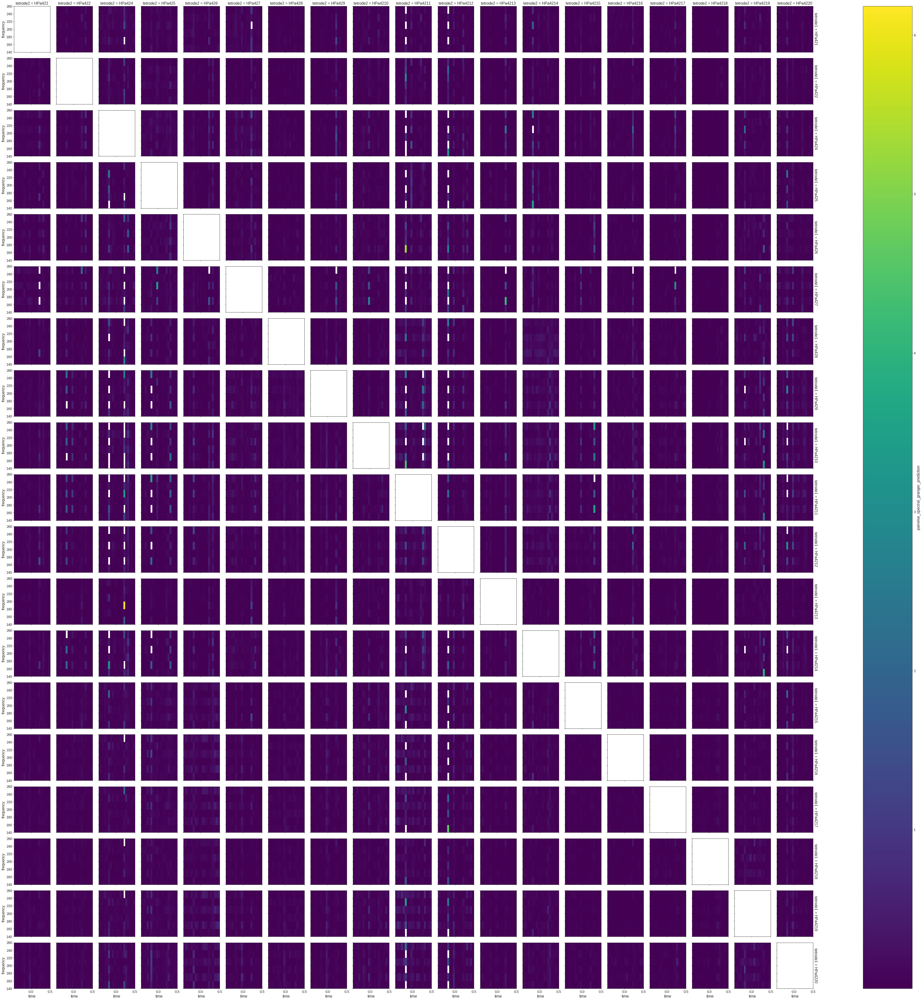

In [40]:
dimension_names = ['time', 'frequency', 'tetrode1', 'tetrode2']
data_vars = {'pairwise_spectral_granger_prediction': (
    dimension_names, c.pairwise_spectral_granger_prediction())}
coordinates = {
    'time': _center_time(c.time),
    'frequency': c.frequencies + np.diff(c.frequencies)[0] / 2,
    'tetrode1': tetrode_info.tetrode_id.values,
    'tetrode2': tetrode_info.tetrode_id.values,
    'brain_area1': ('tetrode1', tetrode_info.area.tolist()),
    'brain_area2': ('tetrode2', tetrode_info.area.tolist()),
}
spectral_granger = xr.Dataset(data_vars, coords=coordinates).sel(
    frequency=slice(FREQUENCY_BANDS['ripple'][0], FREQUENCY_BANDS['ripple'][1])
).pairwise_spectral_granger_prediction

spectral_granger.plot(x='time', y='frequency', row='tetrode1', col='tetrode2');

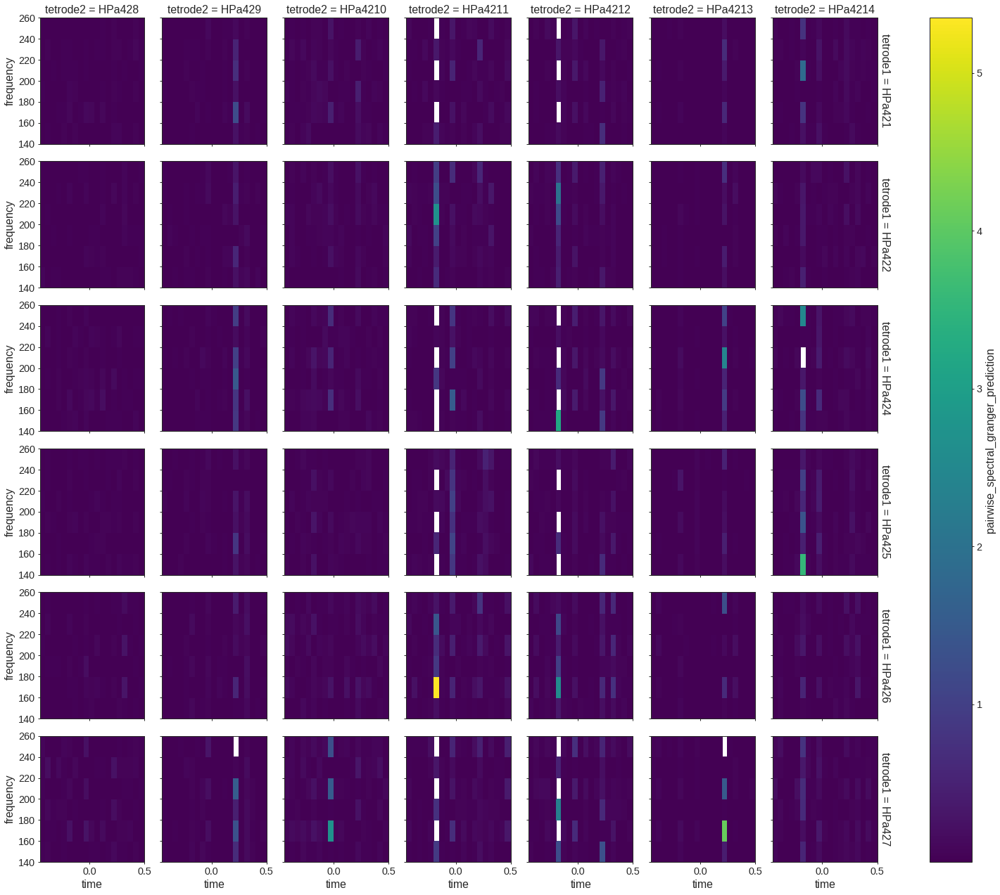

In [41]:
spectral_granger.sel(
    tetrode1=spectral_granger.tetrode1[coherence_magnitude.brain_area1 == 'CA1'],
    tetrode2=spectral_granger.tetrode2[coherence_magnitude.brain_area2 == 'iCA1']
).plot(x='time', y='frequency', row='tetrode1', col='tetrode2');

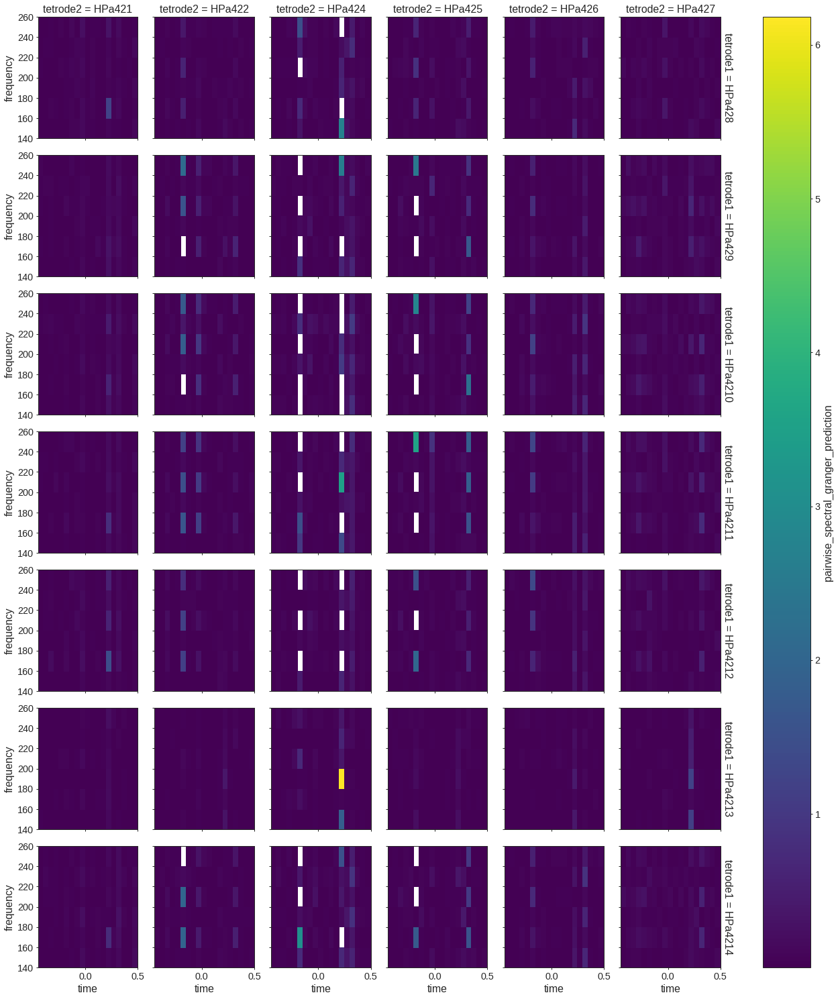

In [42]:
spectral_granger.sel(
    tetrode1=spectral_granger.tetrode1[coherence_magnitude.brain_area1 == 'iCA1'],
    tetrode2=spectral_granger.tetrode2[coherence_magnitude.brain_area2 == 'CA1']
).plot(x='time', y='frequency', row='tetrode1', col='tetrode2');

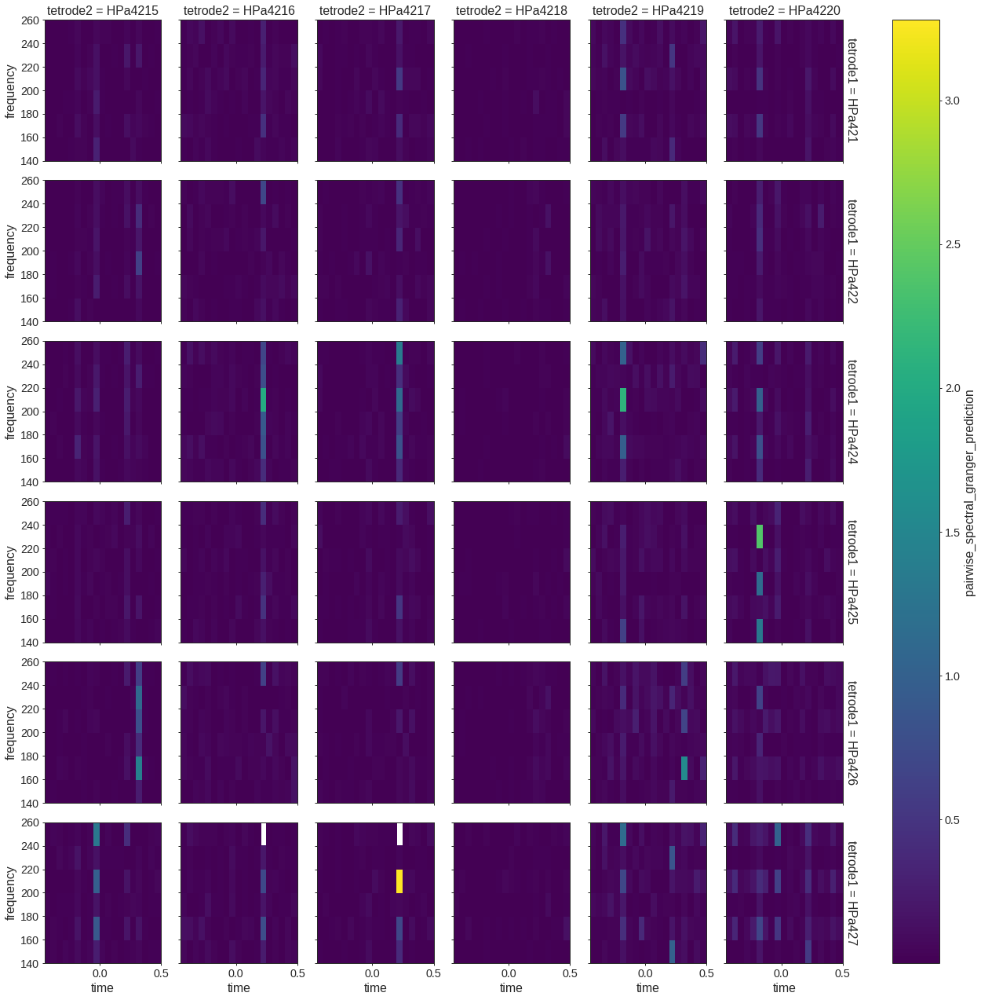

In [43]:
spectral_granger.sel(
    tetrode1=spectral_granger.tetrode1[coherence_magnitude.brain_area1 == 'CA1'],
    tetrode2=spectral_granger.tetrode2[coherence_magnitude.brain_area2 == 'PFC']
).plot(x='time', y='frequency', row='tetrode1', col='tetrode2');

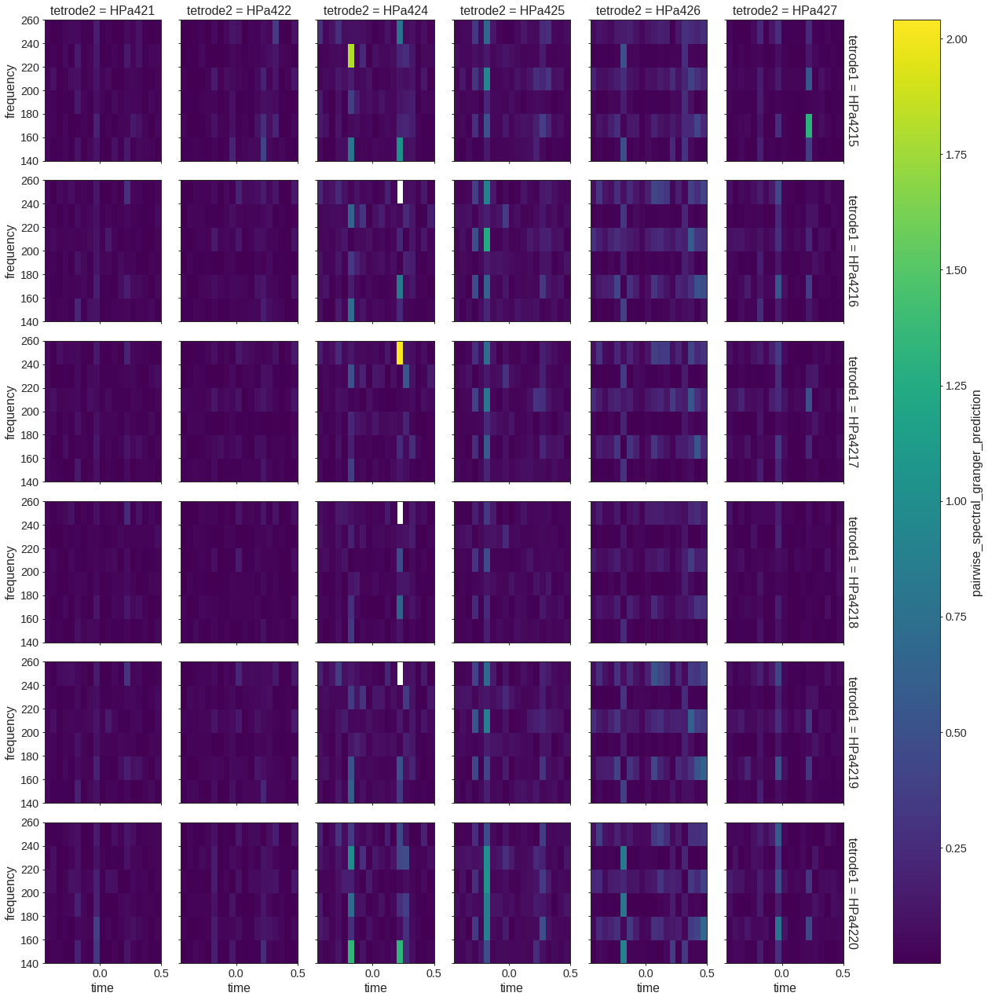

In [44]:
spectral_granger.sel(
    tetrode1=spectral_granger.tetrode1[coherence_magnitude.brain_area1 == 'PFC'],
    tetrode2=spectral_granger.tetrode2[coherence_magnitude.brain_area2 == 'CA1']
).plot(x='time', y='frequency', row='tetrode1', col='tetrode2');

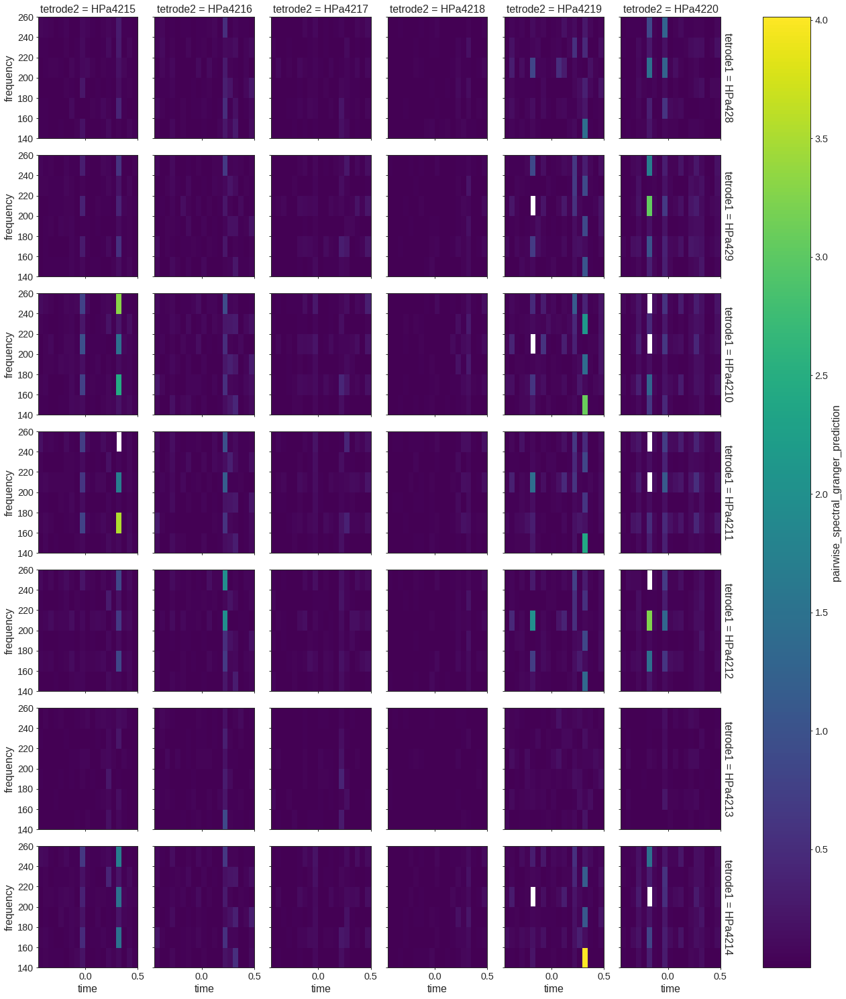

In [45]:
spectral_granger.sel(
    tetrode1=spectral_granger.tetrode1[coherence_magnitude.brain_area1 == 'iCA1'],
    tetrode2=spectral_granger.tetrode2[coherence_magnitude.brain_area2 == 'PFC']
).plot(x='time', y='frequency', row='tetrode1', col='tetrode2');

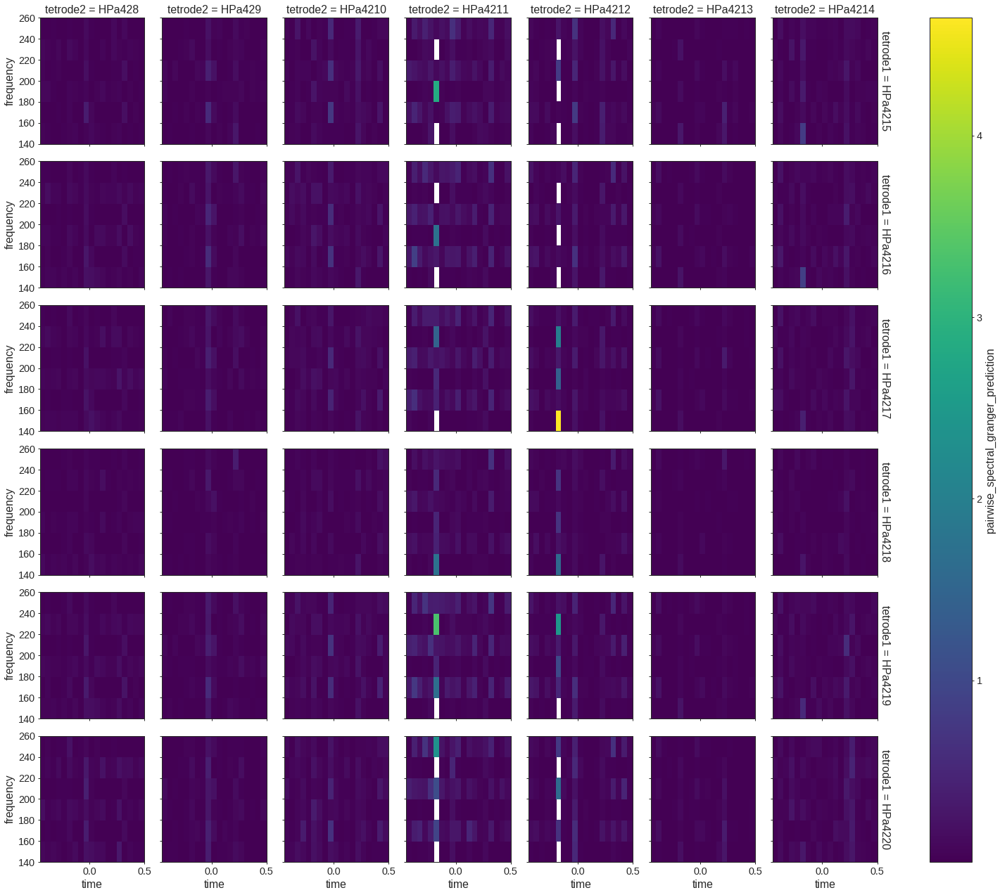

In [46]:
spectral_granger.sel(
    tetrode1=spectral_granger.tetrode1[coherence_magnitude.brain_area1 == 'PFC'],
    tetrode2=spectral_granger.tetrode2[coherence_magnitude.brain_area2 == 'iCA1']
).plot(x='time', y='frequency', row='tetrode1', col='tetrode2');

## Focus on single tetrode pair

Spectral granger doesn't look right. Group delay may look correct but we don't know. Coherence values are low.

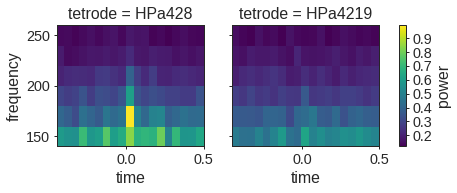

In [47]:
tetrode1 = 'HPa428' #iCA1
tetrode2 = 'HPa4219'

ripple_power.sel(tetrode=[tetrode1, tetrode2]).plot(x='time', y='frequency', col='tetrode');

The coherence is surprising in this plot, given that the power isn't high for `HPa4219`.

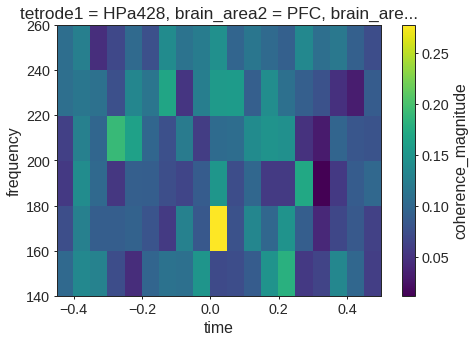

In [48]:
coherence_magnitude.sel(tetrode1=tetrode1, tetrode2=tetrode2).plot(x='time', y='frequency', size=5);

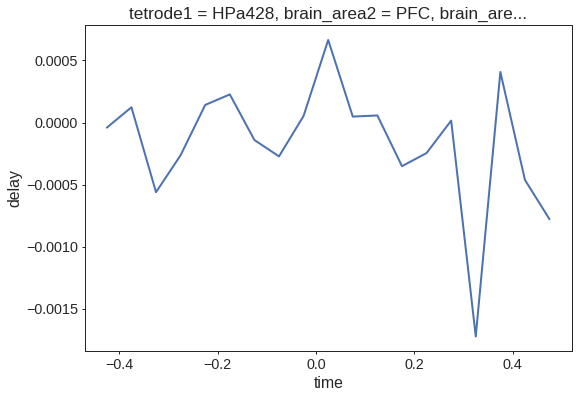

In [49]:
group_delay.sel(tetrode1=tetrode1, tetrode2=tetrode2).plot(size=6);

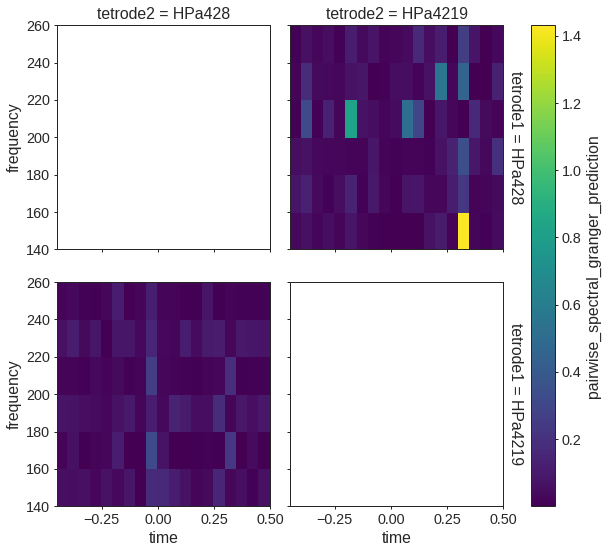

In [50]:
spectral_granger.sel(
    tetrode1=[tetrode1, tetrode2], tetrode2=[tetrode1, tetrode2]
).plot(x='time', y='frequency', row='tetrode1', col='tetrode2', size=4);

Maybe it's something to do with the shape of the entered data?

In [51]:
ripple_locked_lfps

<class 'pandas.core.panel.Panel'>
Dimensions: 19 (items) x 1426 (major_axis) x 137 (minor_axis)
Items axis: (HPa, 4, 2, 1) to (HPa, 4, 2, 20)
Major_axis axis: -0.45 to 0.5
Minor_axis axis: (1, 2711.43393333, 2711.47926667, electric_potential) to (137, 3909.18926667, 3909.24993333, electric_potential)

In [52]:
ripple_times.shape[0]

137

In [53]:
tetrode_info.shape[0]

19

In [54]:
ripple_locked_lfps.major_axis

Float64Index([  -0.45, -0.4493, -0.4487,  -0.448, -0.4473, -0.4467,  -0.446,
              -0.4453, -0.4447,  -0.444,
              ...
                0.494,  0.4947,  0.4953,   0.496,  0.4967,  0.4973,   0.498,
               0.4987,  0.4993,     0.5],
             dtype='float64', name='time', length=1426)

In [55]:
l = np.rollaxis(ripple_locked_lfps.values, 0, 3)
l.shape

(1426, 137, 19)

Shapes check out. Try only two tetrodes:

In [56]:
tetrode1_key = ('HPa', 4, 2, 8)
tetrode2_key = ('HPa', 4, 2, 19)
l2 = np.rollaxis(ripple_locked_lfps.loc[[tetrode1_key, tetrode2_key]], 0, 3).values
l2.shape

(1426, 137, 2)

In [57]:
m2 = Multitaper(l2, **params, start_time=ripple_locked_lfps.major_axis.min())

In [58]:
m2.fft().shape

(19, 137, 1, 75, 2)

In [59]:
m2.time.shape[0]

19

In [60]:
m2.frequencies.shape[0]

75

In [61]:
c2 = Connectivity.from_multitaper(m2)
c2.power().shape

(19, 38, 2)

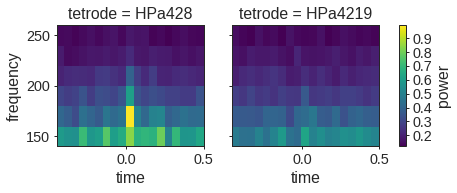

In [62]:
dimension_names = ['time', 'frequency', 'tetrode']
data_vars = {
 'power': (dimension_names, c2.power())}
coordinates = {
    'time': _center_time(c2.time),
    'frequency': c2.frequencies + np.diff(c2.frequencies)[0] / 2,
    'tetrode': tetrode_info.loc[[tetrode1_key, tetrode2_key]].tetrode_id.values,
    'brain_area': ('tetrode', tetrode_info.loc[[tetrode1_key, tetrode2_key]].area.tolist()),
}

ripple_power = xr.Dataset(data_vars, coords=coordinates).sel(
    frequency=slice(FREQUENCY_BANDS['ripple'][0], FREQUENCY_BANDS['ripple'][1])
).power

ripple_power.plot(x='time', y='frequency', col='tetrode');

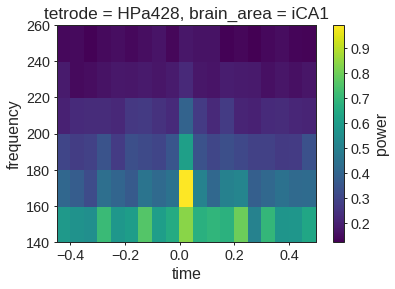

In [63]:
ripple_power.isel(tetrode=0).plot(x='time', y='frequency', size=4);

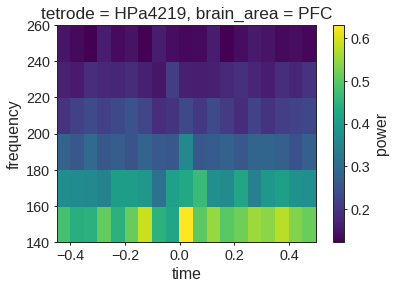

In [64]:
ripple_power.isel(tetrode=1).plot(x='time', y='frequency', size=4);

Compare to scipy's spectrogram:

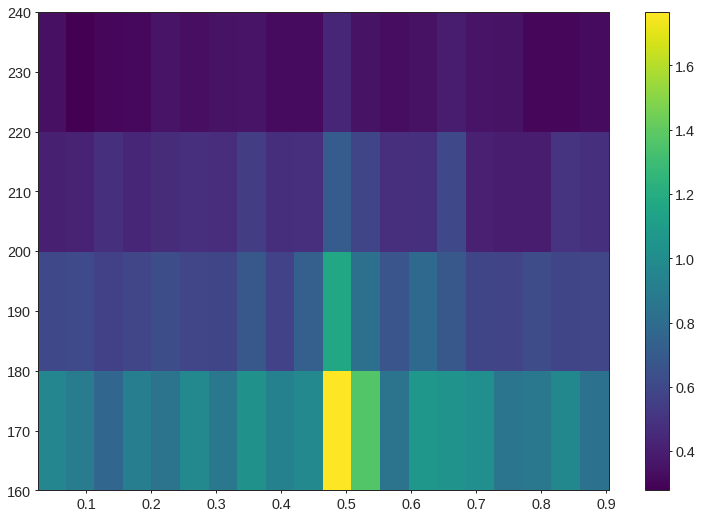

In [65]:
import scipy.signal

f, t, Sxx = scipy.signal.spectrogram(
    l2[..., 0], axis=0, fs=SAMPLING_FREQUENCY, nperseg=75)

plt.pcolormesh(t, f[(f > 150) & ( f < 250)], Sxx.mean(axis=1)[(f > 150) & ( f < 250), :], cmap='viridis');
plt.colorbar();

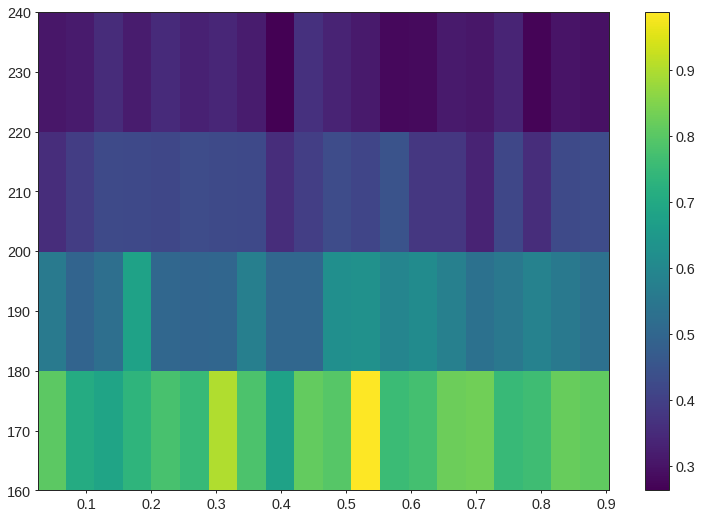

In [66]:
f, t, Sxx = scipy.signal.spectrogram(
    l2[..., 1], axis=0, fs=SAMPLING_FREQUENCY, nperseg=75)

plt.pcolormesh(t, f[(f > 150) & ( f < 250)], Sxx.mean(axis=1)[(f > 150) & ( f < 250), :], cmap='viridis')
plt.colorbar();

The spectrograms from scipy and my code look roughly comparable. Maybe adding more tapers will stabilize?

In [67]:
m_more_tapers = Multitaper(
    l2,
    sampling_frequency=params['sampling_frequency'],
    time_window_duration=params['time_window_duration'],
    time_window_step=params['time_window_step'],
    time_halfbandwidth_product=3,
    start_time=ripple_locked_lfps.major_axis.min()
)

c_more_tapers = Connectivity.from_multitaper(m_more_tapers)

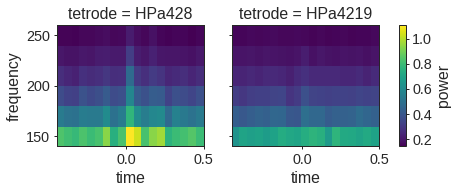

In [68]:
dimension_names = ['time', 'frequency', 'tetrode']
data_vars = {
 'power': (dimension_names, c_more_tapers.power())}
coordinates = {
    'time': _center_time(c_more_tapers.time),
    'frequency': c_more_tapers.frequencies + np.diff(c_more_tapers.frequencies)[0] / 2,
    'tetrode': tetrode_info.loc[[tetrode1_key, tetrode2_key]].tetrode_id.values,
    'brain_area': ('tetrode', tetrode_info.loc[[tetrode1_key, tetrode2_key]].area.tolist()),
}

ripple_power = xr.Dataset(data_vars, coords=coordinates).sel(
    frequency=slice(FREQUENCY_BANDS['ripple'][0], FREQUENCY_BANDS['ripple'][1])
).power

ripple_power.plot(x='time', y='frequency', col='tetrode');

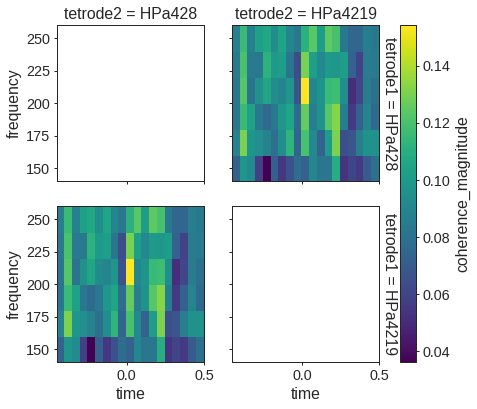

In [69]:
dimension_names = ['time', 'frequency', 'tetrode1', 'tetrode2']
data_vars = {
 'coherence_magnitude': (dimension_names, c_more_tapers.coherence_magnitude())}
coordinates = {
    'time': _center_time(c_more_tapers.time),
    'frequency': c_more_tapers.frequencies + np.diff(c_more_tapers.frequencies)[0] / 2,
    'tetrode1': tetrode_info.loc[[tetrode1_key, tetrode2_key]].tetrode_id.values,
    'tetrode2': tetrode_info.loc[[tetrode1_key, tetrode2_key]].tetrode_id.values,
    'brain_area1': ('tetrode1', tetrode_info.loc[[tetrode1_key, tetrode2_key]].area.tolist()),
    'brain_area2': ('tetrode2', tetrode_info.loc[[tetrode1_key, tetrode2_key]].area.tolist()),
}

coherence_magnitude = xr.Dataset(data_vars, coords=coordinates)
coherence_magnitude = coherence_magnitude.sel(
    frequency=slice(FREQUENCY_BANDS['ripple'][0], FREQUENCY_BANDS['ripple'][1])
).coherence_magnitude

coherence_magnitude.plot(x='time', y='frequency', row='tetrode1', col='tetrode2');

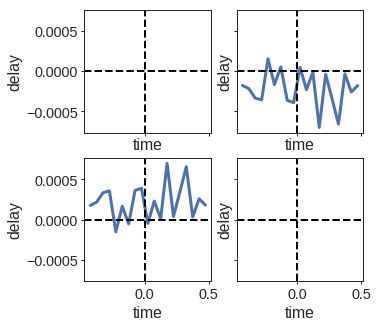

In [70]:
group_delay = np.array(
    [c_more_tapers.group_delay(FREQUENCY_BANDS[frequency_band],
                   frequency_resolution=m.frequency_resolution)
     for frequency_band in FREQUENCY_BANDS])

dimension_names = ['frequency_band', 'time', 'tetrode1', 'tetrode2']
data_vars = {
    'delay': (dimension_names, group_delay[:, 0, ...]),
    'slope': (dimension_names, group_delay[:, 1, ...]),
    'r_value': (dimension_names, group_delay[:, 2, ...])}

coordinates = {
    'time': _center_time(c_more_tapers.time),
    'frequency_band': list(FREQUENCY_BANDS.keys()),
    'tetrode1': tetrode_info.loc[[tetrode1_key, tetrode2_key]].tetrode_id.values,
    'tetrode2': tetrode_info.loc[[tetrode1_key, tetrode2_key]].tetrode_id.values,
    'brain_area1': ('tetrode1', tetrode_info.loc[[tetrode1_key, tetrode2_key]].area.tolist()),
    'brain_area2': ('tetrode2', tetrode_info.loc[[tetrode1_key, tetrode2_key]].area.tolist()),
    }

group_delay = xr.Dataset(data_vars, coords=coordinates).sel(frequency_band='ripple').delay

_, n_tetrodes1, n_tetrodes2 = group_delay.shape

fig, ax = plt.subplots(n_tetrodes1, n_tetrodes2, sharex=True, sharey=True, figsize=(5, 5))

for ind1, ind2 in product(range(n_tetrodes1), range(n_tetrodes2)):
    group_delay.isel(tetrode1=ind1, tetrode2=ind2).plot(ax=ax[ind1, ind2], linewidth=3);
    ax[ind1, ind2].set_title('', fontsize=5)
    ax[ind1, ind2].axvline(0, color='black', linestyle='--')
    ax[ind1, ind2].axhline(0, color='black', linestyle='--')

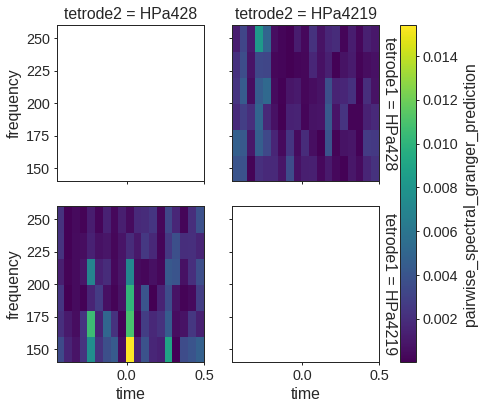

In [71]:
dimension_names = ['time', 'frequency', 'tetrode1', 'tetrode2']
data_vars = {'pairwise_spectral_granger_prediction': (
    dimension_names, c_more_tapers.pairwise_spectral_granger_prediction())}
coordinates = {
    'time': _center_time(c_more_tapers.time),
    'frequency': c_more_tapers.frequencies + np.diff(c_more_tapers.frequencies)[0] / 2,
    'tetrode1': tetrode_info.loc[[tetrode1_key, tetrode2_key]].tetrode_id.values,
    'tetrode2': tetrode_info.loc[[tetrode1_key, tetrode2_key]].tetrode_id.values,
    'brain_area1': ('tetrode1', tetrode_info.loc[[tetrode1_key, tetrode2_key]].area.tolist()),
    'brain_area2': ('tetrode2', tetrode_info.loc[[tetrode1_key, tetrode2_key]].area.tolist()),
}
spectral_granger = xr.Dataset(data_vars, coords=coordinates).sel(
    frequency=slice(FREQUENCY_BANDS['ripple'][0], FREQUENCY_BANDS['ripple'][1])
).pairwise_spectral_granger_prediction

spectral_granger.plot(x='time', y='frequency', row='tetrode1', col='tetrode2');

In [72]:
c_more_tapers2 = Connectivity.from_multitaper(m_more_tapers, expectation_type='tapers')
c_more_tapers2.coherence_phase().shape

(19, 137, 38, 2, 2)

In [73]:
dimension_names = ['time', 'ripples', 'frequency', 'tetrode1', 'tetrode2']
data_vars = {
 'coherency': (dimension_names, c_more_tapers2.coherency())}
coordinates = {
    'time': _center_time(c_more_tapers2.time),
    'ripples': np.arange(137) + 1,
    'frequency': c_more_tapers2.frequencies + np.diff(c_more_tapers2.frequencies)[0] / 2,
    'tetrode1': tetrode_info.loc[[tetrode1_key, tetrode2_key]].tetrode_id.values,
    'tetrode2': tetrode_info.loc[[tetrode1_key, tetrode2_key]].tetrode_id.values,
    'brain_area1': ('tetrode1', tetrode_info.loc[[tetrode1_key, tetrode2_key]].area.tolist()),
    'brain_area2': ('tetrode2', tetrode_info.loc[[tetrode1_key, tetrode2_key]].area.tolist()),
}

coherence = xr.Dataset(data_vars, coords=coordinates).sel(
    frequency=slice(FREQUENCY_BANDS['ripple'][0], FREQUENCY_BANDS['ripple'][1])
).coherency

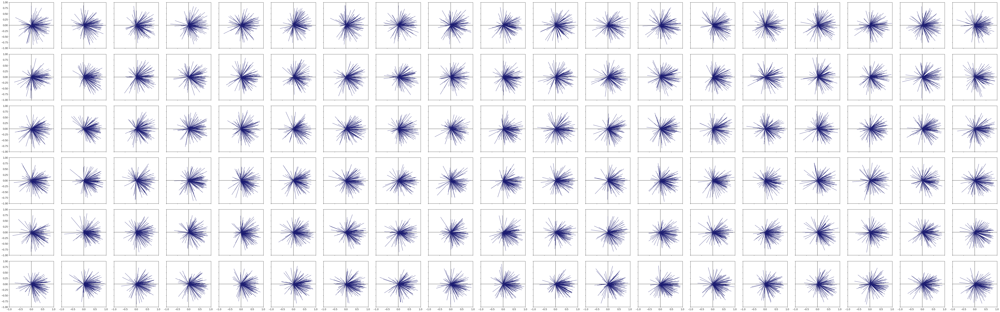

In [103]:
blah = coherence.isel(tetrode1=0, tetrode2=1)

n_freq = len(blah.frequency)
n_time = len(blah.time)
fig, axes = plt.subplots(n_freq, n_time, figsize=(4 * n_time, n_freq * 4), sharex=True, sharey=True)

for ind1, ind2 in product(range(n_freq), range(n_time)):
    for ripple in blah.isel(frequency=ind1, time=ind2):
        axes[ind1, ind2].set_xlim([-1, 1])
        axes[ind1, ind2].set_ylim([-1, 1])
        axes[ind1, ind2].axvline(0, color='grey', alpha=0.01)
        axes[ind1, ind2].axhline(0, color='grey', alpha=0.01)
        axes[ind1, ind2].arrow(0, 0, ripple.real, ripple.imag, color='midnightblue')
        
plt.tight_layout()

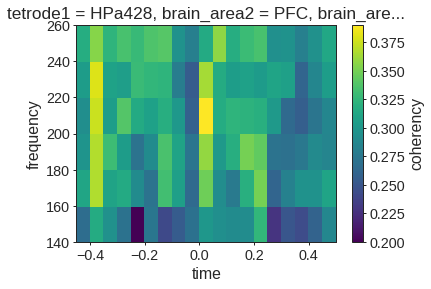

In [114]:
np.abs(coherence.isel(tetrode1=0, tetrode2=1).mean(['ripples'])).plot(x='time', y='frequency', size=4);

Let's look at all the tetrode pairs with more tapers:

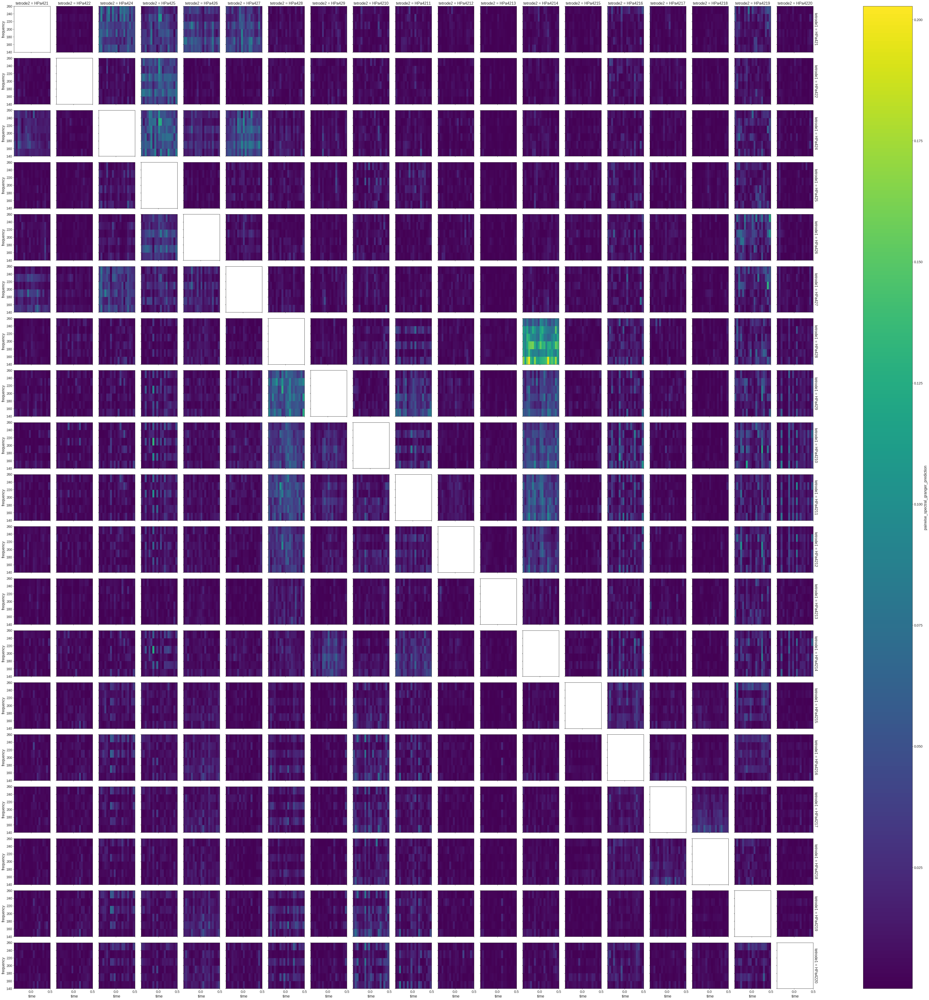

In [121]:
m_more_tapers = Multitaper(
    l,
    sampling_frequency=SAMPLING_FREQUENCY,
    time_window_duration=0.050,
    time_halfbandwidth_product=2,
    start_time=ripple_locked_lfps.major_axis.min()
)

c_more_tapers = Connectivity.from_multitaper(m_more_tapers)

dimension_names = ['time', 'frequency', 'tetrode1', 'tetrode2']
data_vars = {'pairwise_spectral_granger_prediction': (
    dimension_names, c_more_tapers.pairwise_spectral_granger_prediction())}
coordinates = {
    'time': _center_time(c_more_tapers.time),
    'frequency': c_more_tapers.frequencies + np.diff(c_more_tapers.frequencies)[0] / 2,
    'tetrode1': tetrode_info.tetrode_id.values,
    'tetrode2': tetrode_info.tetrode_id.values,
    'brain_area1': ('tetrode1', tetrode_info.area.tolist()),
    'brain_area2': ('tetrode2', tetrode_info.area.tolist()),
}
spectral_granger = xr.Dataset(data_vars, coords=coordinates).sel(
    frequency=slice(FREQUENCY_BANDS['ripple'][0], FREQUENCY_BANDS['ripple'][1])
).pairwise_spectral_granger_prediction

spectral_granger.plot(x='time', y='frequency', row='tetrode1', col='tetrode2');

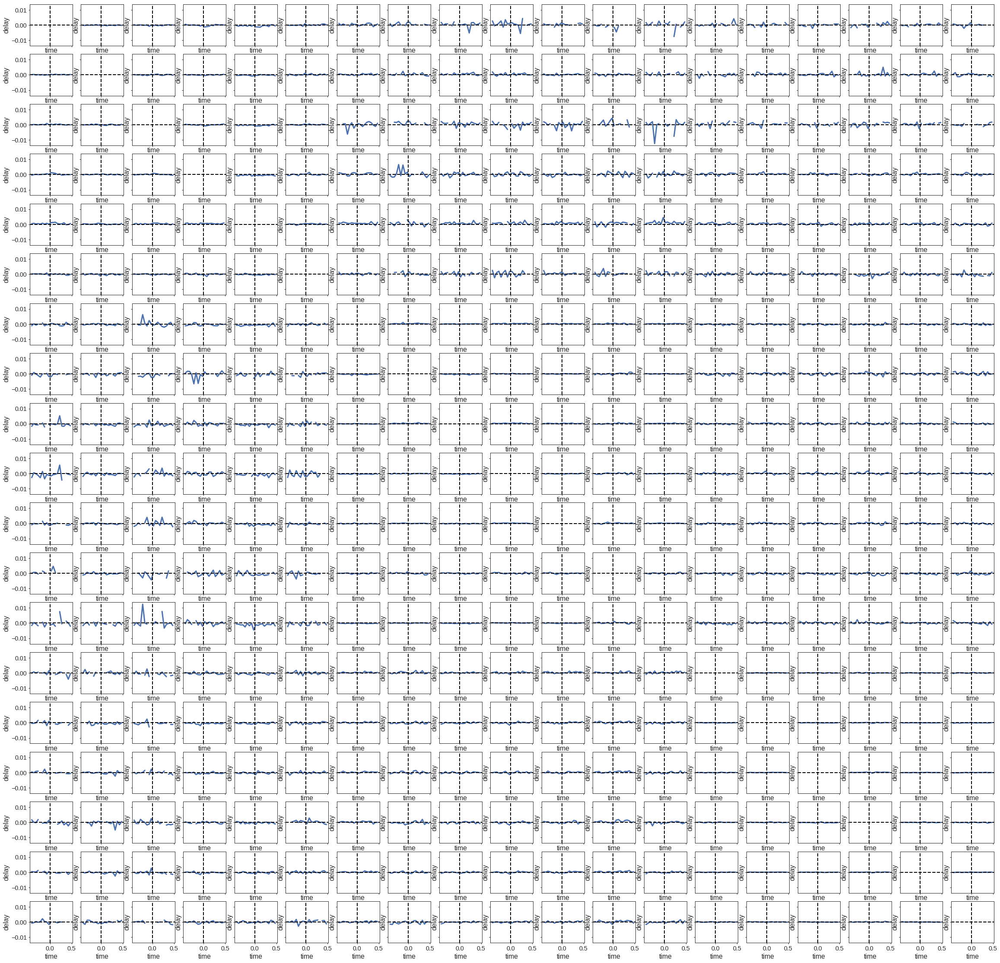

In [124]:
group_delay = np.array(
    [c_more_tapers.group_delay(FREQUENCY_BANDS[frequency_band],
                   frequency_resolution=m.frequency_resolution)
     for frequency_band in FREQUENCY_BANDS])

dimension_names = ['frequency_band', 'time', 'tetrode1', 'tetrode2']
data_vars = {
    'delay': (dimension_names, group_delay[:, 0, ...]),
    'slope': (dimension_names, group_delay[:, 1, ...]),
    'r_value': (dimension_names, group_delay[:, 2, ...])}

coordinates = {
    'time': _center_time(c_more_tapers.time),
    'frequency_band': list(FREQUENCY_BANDS.keys()),
    'tetrode1': tetrode_info.tetrode_id.values,
    'tetrode2': tetrode_info.tetrode_id.values,
    'brain_area1': ('tetrode1', tetrode_info.area.tolist()),
    'brain_area2': ('tetrode2', tetrode_info.area.tolist()),
    }

group_delay = xr.Dataset(data_vars, coords=coordinates).sel(frequency_band='ripple').delay

_, n_tetrodes1, n_tetrodes2 = group_delay.shape

fig, ax = plt.subplots(n_tetrodes1, n_tetrodes2, sharex=True, sharey=True, figsize=(40, 40))

for ind1, ind2 in product(range(n_tetrodes1), range(n_tetrodes2)):
    group_delay.isel(tetrode1=ind1, tetrode2=ind2).plot(ax=ax[ind1, ind2], linewidth=3);
    ax[ind1, ind2].set_title('', fontsize=5)
    ax[ind1, ind2].axvline(0, color='black', linestyle='--')
    ax[ind1, ind2].axhline(0, color='black', linestyle='--')

In [143]:
m_whole_trial = Multitaper(
    np.rollaxis(pd.Panel(lfps), 0, 3).values,
    sampling_frequency=SAMPLING_FREQUENCY,
    time_window_duration=1.000,
    time_halfbandwidth_product=2,
    start_time=0
)

c_whole_trial = Connectivity.from_multitaper(m_whole_trial)
m_whole_trial.frequency_resolution

2.0

In [144]:
dimension_names = ['time', 'frequency', 'tetrode']
data_vars = {
     'power': (dimension_names, c_whole_trial.power())}
coordinates = {
    'time': _center_time(c_whole_trial.time),
    'frequency': c_whole_trial.frequencies + np.diff(c_whole_trial.frequencies)[0] / 2,
    'tetrode': tetrode_info.tetrode_id.values,
    'brain_area': ('tetrode', tetrode_info.area.tolist()),
}

power = xr.Dataset(data_vars, coords=coordinates).power

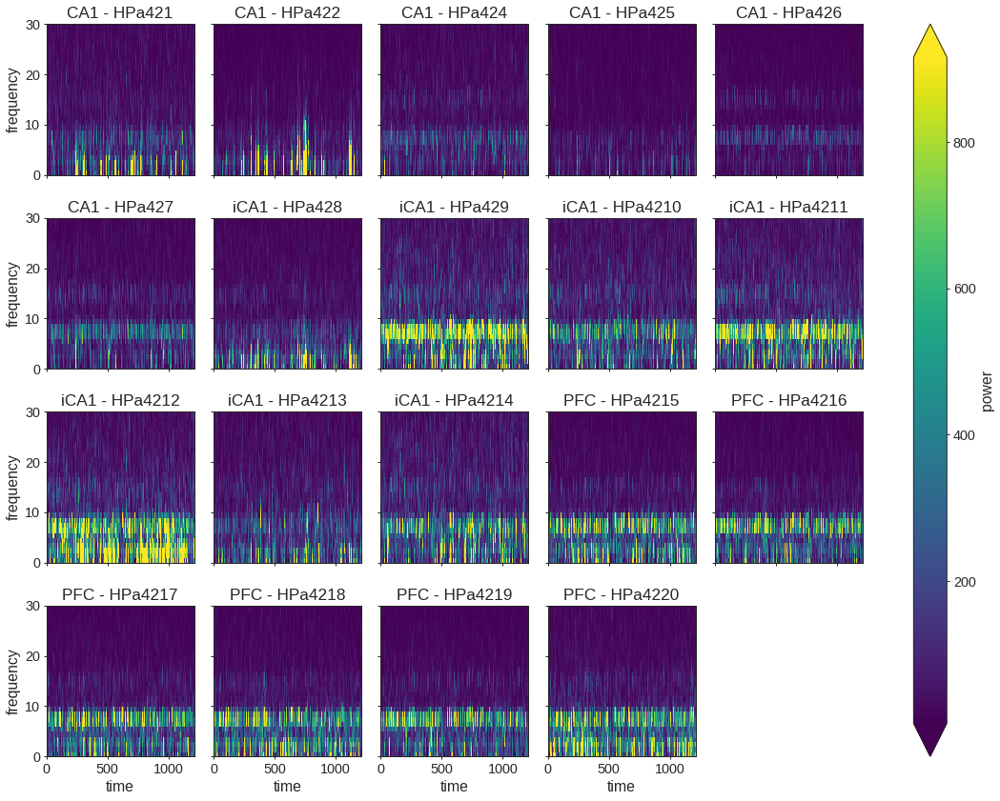

In [145]:
g = power.sel(frequency=slice(0, 30)).plot(x='time', y='frequency', col='tetrode', col_wrap=5, robust=True);

for ax, area, tetrode in zip(g.axes.ravel().tolist(), g.data.brain_area, g.data.tetrode):
    ax.set_title(
        '{brain_area} - {tetrode_id}'.format(brain_area=area.values, tetrode_id=tetrode.values))
    ax.axvline(0, color='black', linestyle='--')

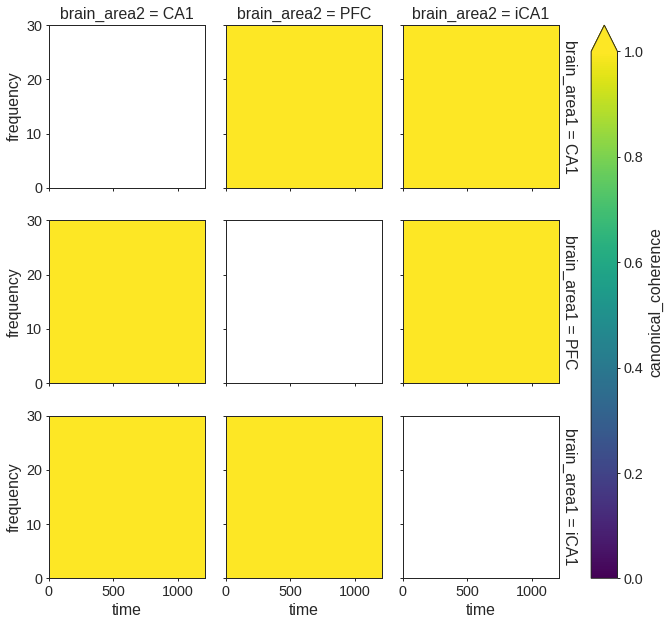

In [151]:
canonical_coherence, area_labels = c_whole_trial.canonical_coherence(
    tetrode_info.area.tolist())
dimension_names = ['time', 'frequency', 'brain_area1', 'brain_area2']
data_vars = {
    'canonical_coherence': (dimension_names, canonical_coherence)}
coordinates = {
    'time': _center_time(c_whole_trial.time),
    'frequency': c_whole_trial.frequencies + np.diff(c_whole_trial.frequencies)[0] / 2,
    'brain_area1': area_labels,
    'brain_area2': area_labels,
}
canonical_coherence = xr.Dataset(data_vars, coords=coordinates).canonical_coherence
canonical_coherence.sel(frequency=slice(0, 30)).plot(
    x='time', y='frequency', row='brain_area1', col='brain_area2', vmax=1, vmin=0);

In [150]:
canonical_coherence.max()

<xarray.DataArray 'canonical_coherence' ()>
array(1.0000000000000049)

In [149]:
canonical_coherence.min()

<xarray.DataArray 'canonical_coherence' ()>
array(0.9999999999999964)

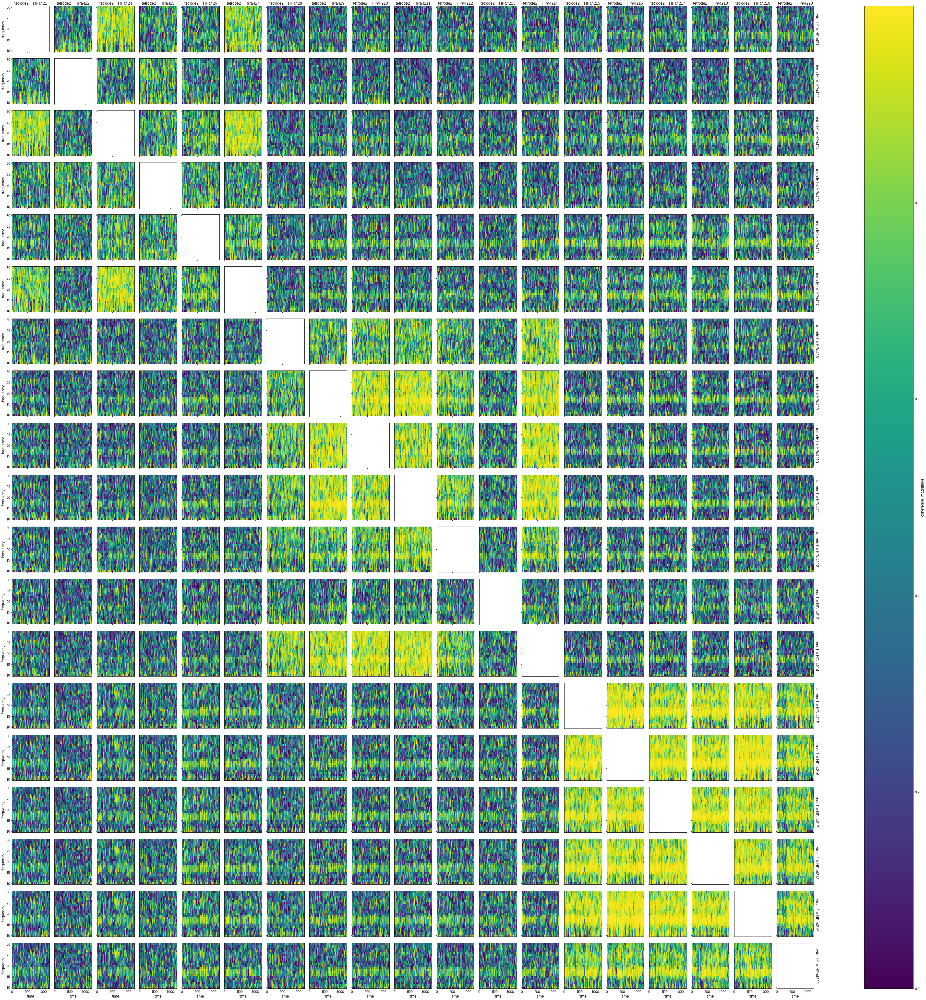

In [152]:
dimension_names = ['time', 'frequency', 'tetrode1', 'tetrode2']
data_vars = {
 'coherence_magnitude': (dimension_names, c_whole_trial.coherence_magnitude())}
coordinates = {
    'time': _center_time(c_whole_trial.time),
    'frequency': c_whole_trial.frequencies + np.diff(c.frequencies)[0] / 2,
    'tetrode1': tetrode_info.tetrode_id.values,
    'tetrode2': tetrode_info.tetrode_id.values,
    'brain_area1': ('tetrode1', tetrode_info.area.tolist()),
    'brain_area2': ('tetrode2', tetrode_info.area.tolist()),
}

coherence_magnitude = xr.Dataset(data_vars, coords=coordinates).coherence_magnitude

coherence_magnitude.sel(frequency=slice(0, 30)).plot(x='time', y='frequency', row='tetrode1', col='tetrode2');

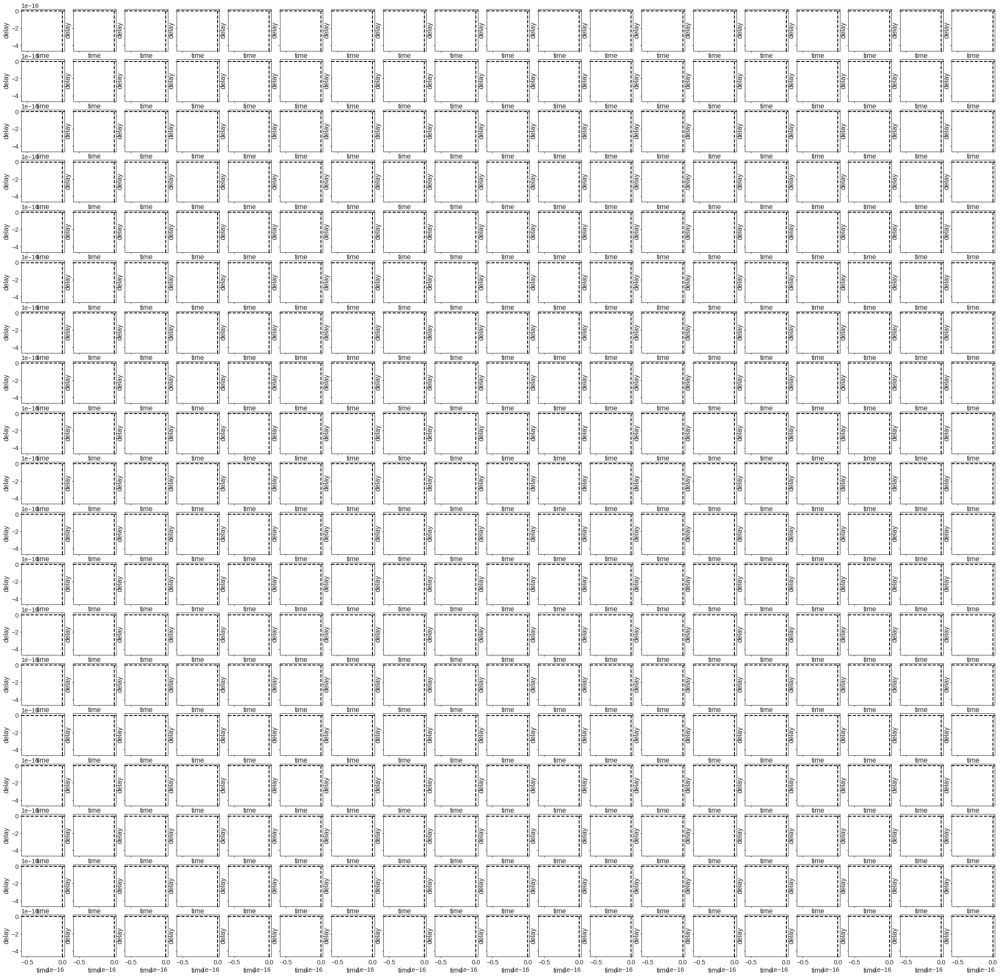

In [153]:
group_delay = np.array(
    [c_whole_trial.group_delay(FREQUENCY_BANDS[frequency_band],
                   frequency_resolution=m.frequency_resolution)
     for frequency_band in FREQUENCY_BANDS])

dimension_names = ['frequency_band', 'time', 'tetrode1', 'tetrode2']
data_vars = {
    'delay': (dimension_names, group_delay[:, 0, ...]),
    'slope': (dimension_names, group_delay[:, 1, ...]),
    'r_value': (dimension_names, group_delay[:, 2, ...])}

coordinates = {
    'time': _center_time(c_whole_trial.time),
    'frequency_band': list(FREQUENCY_BANDS.keys()),
    'tetrode1': tetrode_info.tetrode_id.values,
    'tetrode2': tetrode_info.tetrode_id.values,
    'brain_area1': ('tetrode1', tetrode_info.area.tolist()),
    'brain_area2': ('tetrode2', tetrode_info.area.tolist()),
    }

group_delay = xr.Dataset(data_vars, coords=coordinates).sel(frequency_band='theta').delay

In [154]:
group_delay


<xarray.DataArray 'delay' (time: 1210, tetrode1: 19, tetrode2: 19)>
array([[[ nan,  nan, ...,  nan,  nan],
        [ nan,  nan, ...,  nan,  nan],
        ..., 
        [ nan,  nan, ...,  nan,  nan],
        [ nan,  nan, ...,  nan,  nan]],

       [[ nan,  nan, ...,  nan,  nan],
        [ nan,  nan, ...,  nan,  nan],
        ..., 
        [ nan,  nan, ...,  nan,  nan],
        [ nan,  nan, ...,  nan,  nan]],

       ..., 
       [[ nan,  nan, ...,  nan,  nan],
        [ nan,  nan, ...,  nan,  nan],
        ..., 
        [ nan,  nan, ...,  nan,  nan],
        [ nan,  nan, ...,  nan,  nan]],

       [[ nan,  nan, ...,  nan,  nan],
        [ nan,  nan, ...,  nan,  nan],
        ..., 
        [ nan,  nan, ...,  nan,  nan],
        [ nan,  nan, ...,  nan,  nan]]])
Coordinates:
  * time            (time) float64 0.5 1.5 2.5 3.5 4.5 5.5 6.5 7.5 8.5 9.5 ...
  * tetrode1        (tetrode1) object 'HPa421' 'HPa422' 'HPa424' 'HPa425' ...
    brain_area2     (tetrode2) <U4 'CA1' 'CA1' 'CA1' 'CA1' 'C

In [ ]:
dimension_names = ['time', 'frequency', 'tetrode1', 'tetrode2']
data_vars = {'pairwise_spectral_granger_prediction': (
    dimension_names, c_whole_trial.pairwise_spectral_granger_prediction())}
coordinates = {
    'time': _center_time(c_whole_trial.time),
    'frequency': c_whole_trial.frequencies + np.diff(c_whole_trial.frequencies)[0] / 2,
    'tetrode1': tetrode_info.tetrode_id.values,
    'tetrode2': tetrode_info.tetrode_id.values,
    'brain_area1': ('tetrode1', tetrode_info.area.tolist()),
    'brain_area2': ('tetrode2', tetrode_info.area.tolist()),
}
spectral_granger = xr.Dataset(data_vars, coords=coordinates).pairwise_spectral_granger_prediction

spectral_granger.sel(frequency=slice(0, 30)).plot(x='time', y='frequency', row='tetrode1', col='tetrode2');